In [2]:
import os
import json
import pandas as pd
import pickle
from PIL import Image
import matplotlib.pyplot as plt
from tqdm.auto import tqdm
from dotenv import load_dotenv
from google import genai
import time

Data analysis

In [3]:
BASE_DIR = os.path.dirname(os.path.abspath('__file__'))
DATASET_DIR = os.path.join(BASE_DIR, "2025_dataset", "train")
IMAGES_DIR = os.path.join(DATASET_DIR, "images_train")

In [3]:
# Load question definitions
questions_path = os.path.join(DATASET_DIR, "closedquestions_definitions_imageclef2025.json")
with open(questions_path, 'r') as f:
    questions = json.load(f)
    
# Convert to DataFrame for easier manipulation
questions_df = pd.json_normalize(questions)[["qid", "question_en", "options_en", "question_type_en", "question_category_en"]]

# Load train data
train_json_path = os.path.join(DATASET_DIR, "train.json")
train_df = pd.read_json(train_json_path)

# Filter relevant columns
train_df = train_df[["encounter_id", "image_ids"]]

# Load CVQA data (ground truth answers)
cvqa_path = os.path.join(DATASET_DIR, "train_cvqa.json")
with open(cvqa_path, 'r') as f:
    cvqa_data = json.load(f)
cvqa_df = pd.json_normalize(cvqa_data)

# Melt to get one row per question
cvqa_long = cvqa_df.melt(id_vars=["encounter_id"], 
                         var_name="qid", 
                         value_name="answer_index")

# Filter out encounter_id rows
cvqa_long = cvqa_long[cvqa_long["qid"] != "encounter_id"]

# Merge CVQA with questions
cvqa_merged = cvqa_long.merge(questions_df, on="qid", how="left")

# Get answer text
def get_answer_text(row):
    try:
        return row["options_en"][row["answer_index"]]
    except (IndexError, TypeError):
        return None

cvqa_merged["answer_text"] = cvqa_merged.apply(get_answer_text, axis=1)

# Merge with train data
final_df = cvqa_merged.merge(train_df, on="encounter_id", how="left")

In [4]:
final_df.head()

,encounter_id,qid,answer_index,question_en,options_en,question_type_en,question_category_en,answer_text,image_ids
0,ENC00001,CQID010-001,1,How much of the body is affected?,"[single spot, limited area, widespread, Not me...",Site,General,limited area,"[IMG_ENC00001_00001.jpg, IMG_ENC00001_00002.jpg]"
1,ENC00002,CQID010-001,1,How much of the body is affected?,"[single spot, limited area, widespread, Not me...",Site,General,limited area,"[IMG_ENC00002_00001.jpg, IMG_ENC00002_00002.jp..."
2,ENC00003,CQID010-001,1,How much of the body is affected?,"[single spot, limited area, widespread, Not me...",Site,General,limited area,"[IMG_ENC00003_00001.jpg, IMG_ENC00003_00002.jp..."
3,ENC00004,CQID010-001,2,How much of the body is affected?,"[single spot, limited area, widespread, Not me...",Site,General,widespread,"[IMG_ENC00004_00001.jpg, IMG_ENC00004_00002.jpg]"
4,ENC00005,CQID010-001,1,How much of the body is affected?,"[single spot, limited area, widespread, Not me...",Site,General,limited area,[IMG_ENC00005_00001.jpg]


In [5]:
# Extract the base CQID code (first 7 characters, e.g., "CQID011" from "CQID011-001")
final_df['base_qid'] = final_df['qid'].str.extract(r'(CQID\d+)')

# Group by encounter_id and base_qid to see all answers for each question family within an encounter
grouped_by_family = final_df.groupby(['encounter_id', 'base_qid']).agg({
    'qid': list,
    'question_en': list,  # Added question_en as requested
    'answer_text': list,
    'answer_index': list,
    'image_ids': 'first',  
    'options_en': 'first',
    'question_type_en': 'first',
    'question_category_en': 'first'
})

# Reset index for easier manipulation
grouped_by_family = grouped_by_family.reset_index()

# Filter to keep only question families with multiple questions (e.g., CQID011-001, CQID011-002, etc.)
question_family_counts = final_df['base_qid'].value_counts()
multi_question_families = question_family_counts[question_family_counts > 1].index.tolist()

# Filter our grouped data to keep only these multi-question families
multi_question_data = grouped_by_family[grouped_by_family['base_qid'].isin(multi_question_families)]

# Modified function to handle "Not mentioned" properly
def get_valid_answers(row):
    """
    Extract all valid answers, with special handling for "Not mentioned".
    If "Not mentioned" is the only answer for all slots, we keep it.
    Otherwise, we collect all non-"Not mentioned" answers.
    """
    answers = row['answer_text']
    if all(ans == "Not mentioned" for ans in answers):
        return ["Not mentioned"]  # If all are "Not mentioned", return it as valid
    
    valid = []
    for ans in answers:
        if ans != "Not mentioned" and ans not in valid:
            valid.append(ans)
    return valid

# Apply to all question families
multi_question_data['valid_answers'] = multi_question_data.apply(get_valid_answers, axis=1)

In [6]:
multi_question_data.head()

,encounter_id,base_qid,qid,question_en,answer_text,answer_index,image_ids,options_en,question_type_en,question_category_en,valid_answers
0,ENC00001,CQID010,[CQID010-001],[How much of the body is affected?],[limited area],[1],"[IMG_ENC00001_00001.jpg, IMG_ENC00001_00002.jpg]","[single spot, limited area, widespread, Not me...",Site,General,[limited area]
1,ENC00001,CQID011,"[CQID011-001, CQID011-002, CQID011-003, CQID01...","[1 Where is the affected area?, 2 Where is the...","[back, Not mentioned, Not mentioned, Not menti...","[5, 7, 7, 7, 7, 7]","[IMG_ENC00001_00001.jpg, IMG_ENC00001_00002.jpg]","[head, neck, upper extremities, lower extremit...",Site Location,General,[back]
2,ENC00001,CQID012,"[CQID012-001, CQID012-002, CQID012-003, CQID01...",[1 How large are the affected areas? Please sp...,"[size of palm, Not mentioned, Not mentioned, N...","[1, 3, 3, 3, 3, 3]","[IMG_ENC00001_00001.jpg, IMG_ENC00001_00002.jpg]","[size of thumb nail, size of palm, larger area...",Size,General,[size of palm]
3,ENC00001,CQID015,[CQID015-001],[When did the patient first notice the issue?],[Not mentioned],[6],"[IMG_ENC00001_00001.jpg, IMG_ENC00001_00002.jpg]","[within hours, within days, within weeks, with...",Onset,General,[Not mentioned]
4,ENC00001,CQID020,"[CQID020-001, CQID020-002, CQID020-003, CQID02...",[1 What label best describes the affected area...,"[thick or raised, Not mentioned, Not mentioned...","[3, 9, 9, 9, 9, 9, 9, 9, 9]","[IMG_ENC00001_00001.jpg, IMG_ENC00001_00002.jpg]","[raised or bumpy, flat, skin loss or sunken, t...",Skin Description,Skin Specific,[thick or raised]


In [13]:
# Let's count how many question families have more than one valid answer
valid_answer_counts = multi_question_data['valid_answers'].apply(len)
multi_valid_answer_counts = valid_answer_counts[valid_answer_counts > 1].count()

print(f"Number of question families with more than one valid answer: {multi_valid_answer_counts}")
single_valid_answer_counts = valid_answer_counts[valid_answer_counts == 1].count()
print(f"Number of question families with one valid answer: {single_valid_answer_counts}")
print(f"Total number of multi-question families: {len(multi_question_data)}")
print(f"Percentage with multiple valid answers: {multi_valid_answer_counts / len(multi_question_data) * 100:.2f}%")

# Let's look at some examples of question families with multiple valid answers
examples_multi_valid = multi_question_data[valid_answer_counts > 1].head(5)
for _, row in examples_multi_valid.iterrows():
    print(f"Encounter ID: {row['encounter_id']}, Base QID: {row['base_qid']}")
    print(f"Questions: {row['qid']}")
    print(f"All answers: {row['answer_text']}")
    print(f"Valid answers: {row['valid_answers']}")
    print()

Number of question families with more than one valid answer: 177
Number of question families with one valid answer: 2523
Total number of multi-question families: 2700
Percentage with multiple valid answers: 6.56%
Encounter ID: ENC00003, Base QID: CQID011
Questions: ['CQID011-001', 'CQID011-002', 'CQID011-003', 'CQID011-004', 'CQID011-005', 'CQID011-006']
All answers: ['back', 'chest/abdomen', 'Not mentioned', 'Not mentioned', 'Not mentioned', 'Not mentioned']
Valid answers: ['back', 'chest/abdomen']

Encounter ID: ENC00003, Base QID: CQID020
Questions: ['CQID020-001', 'CQID020-002', 'CQID020-003', 'CQID020-004', 'CQID020-005', 'CQID020-006', 'CQID020-007', 'CQID020-008', 'CQID020-009']
All answers: ['raised or bumpy', 'scab', 'Not mentioned', 'Not mentioned', 'Not mentioned', 'Not mentioned', 'Not mentioned', 'Not mentioned', 'Not mentioned']
Valid answers: ['raised or bumpy', 'scab']

Encounter ID: ENC00004, Base QID: CQID011
Questions: ['CQID011-001', 'CQID011-002', 'CQID011-003', 'C

In [14]:
# Get instances with only one valid answer
single_valid_answer_data = multi_question_data[multi_question_data['valid_answers'].apply(len) == 1]

# Initialize a counter for unique combinations
unique_combinations = 0

# Iterate through each row in single_valid_answer_data
for _, row in single_valid_answer_data.iterrows():
    encounter_id = row['encounter_id']
    base_qid = row['base_qid']
    image_ids = row['image_ids']
    
    # Count each unique combination of encounter_id, base_qid, image_id
    for image_id in image_ids:
        unique_combinations += 1

print(f"Number of unique encounter_id-base_qid-image_id combinations with one valid answer: {unique_combinations}")

Number of unique encounter_id-base_qid-image_id combinations with one valid answer: 7280


In [15]:
# Get instances with more than one valid answer
multi_valid_answer_data = multi_question_data[multi_question_data['valid_answers'].apply(len) > 1]

# Initialize a counter for unique combinations
unique_combinations = 0

# Iterate through each row in multi_valid_answer_data
for _, row in multi_valid_answer_data.iterrows():
    encounter_id = row['encounter_id']
    base_qid = row['base_qid']
    image_ids = row['image_ids']
    
    # Count each unique combination of encounter_id, base_qid, image_id
    for image_id in image_ids:
        unique_combinations += 1

print(f"Number of unique encounter_id-base_qid-image_id combinations with multiple valid answers: {unique_combinations}")

Number of unique encounter_id-base_qid-image_id combinations with multiple valid answers: 613


In [16]:
# How many unique encounters do we have?
num_encounters = final_df['encounter_id'].nunique()
print(f"Total number of unique encounters: {num_encounters}")

# How many unique question families have multiple slots?
print(f"Number of question families with multiple slots: {len(multi_question_families)}")
print(f"These families are: {multi_question_families}")

# How many encounter-question family combinations do we have in our multi_question_data?
print(f"Total rows in multi_question_data: {len(multi_question_data)}")

# Let's count per question family
family_counts = multi_question_data['base_qid'].value_counts()
print("\nCount of encounters per question family:")
for family, count in family_counts.items():
    print(f"{family}: {count} encounters")

# And now, how many of these have multiple valid answers?
print("\nCount of encounters with multiple valid answers per question family:")
for family in multi_question_families:
    family_data = multi_question_data[multi_question_data['base_qid'] == family]
    multi_valid = family_data['valid_answers'].apply(len) > 1
    count = multi_valid.sum()
    print(f"{family}: {count} encounters with multiple valid answers out of {len(family_data)} total")

Total number of unique encounters: 300
Number of question families with multiple slots: 9
These families are: ['CQID020', 'CQID012', 'CQID011', 'CQID010', 'CQID015', 'CQID025', 'CQID034', 'CQID035', 'CQID036']
Total rows in multi_question_data: 2700

Count of encounters per question family:
CQID010: 300 encounters
CQID011: 300 encounters
CQID012: 300 encounters
CQID015: 300 encounters
CQID020: 300 encounters
CQID025: 300 encounters
CQID034: 300 encounters
CQID035: 300 encounters
CQID036: 300 encounters

Count of encounters with multiple valid answers per question family:
CQID020: 75 encounters with multiple valid answers out of 300 total
CQID012: 9 encounters with multiple valid answers out of 300 total
CQID011: 93 encounters with multiple valid answers out of 300 total
CQID010: 0 encounters with multiple valid answers out of 300 total
CQID015: 0 encounters with multiple valid answers out of 300 total
CQID025: 0 encounters with multiple valid answers out of 300 total
CQID034: 0 encount

Gemini for labeling

In [18]:
load_dotenv()
api_key = os.getenv('API_KEY')
# print(api_key)

In [19]:
gemini_multi_answer_data = []

# Filter to cases with multiple valid answers
multi_valid_answer_data = multi_question_data[multi_question_data['valid_answers'].apply(len) > 1]

for _, row in tqdm(multi_valid_answer_data.iterrows(), desc="Preparing multi-answer data"):
    encounter_id = row['encounter_id']
    base_qid = row['base_qid']
    valid_answers = row['valid_answers']
    image_ids = row['image_ids']
    
    # Include the question text
    question_text = row['question_en'][0]  # Taking the first question as reference
    
    for img_id in image_ids:
        img_path = os.path.join(IMAGES_DIR, img_id)
        
        # Skip if image doesn't exist
        if not os.path.exists(img_path):
            continue
            
        gemini_multi_answer_data.append({
            'encounter_id': encounter_id,
            'base_qid': base_qid,
            'image_id': img_id,
            'image_path': img_path,
            'valid_answers': valid_answers,
            'question_text': question_text
        })

Preparing multi-answer data: 0it [00:00, ?it/s]

In [20]:
print(gemini_multi_answer_data[0])
print(len(gemini_multi_answer_data)) 

# So while we have 177 encounter-question family combinations with multiple valid answers, we have 613 images that do

{'encounter_id': 'ENC00003', 'base_qid': 'CQID011', 'image_id': 'IMG_ENC00003_00001.jpg', 'image_path': '/storage/coda1/p-dsgt_clef2025/0/kthakrar3/mediqa-magic-v2/2025_dataset/train/images_train/IMG_ENC00003_00001.jpg', 'valid_answers': ['back', 'chest/abdomen'], 'question_text': '1 Where is the affected area?'}
613


In [21]:
# Count of encounter-question family combinations with multiple valid answers
print(f"Encounter-question combinations with multiple valid answers: {len(multi_valid_answer_data)}")

# Calculate average images per encounter
avg_images = multi_valid_answer_data['image_ids'].apply(len).mean()
print(f"Average images per encounter: {avg_images:.2f}")

# Expected number of image entries
expected_entries = len(multi_valid_answer_data) * avg_images
print(f"Expected number of image entries: {expected_entries:.0f}")

# Actual number of image entries
print(f"Actual number of image entries: {len(gemini_multi_answer_data)}")

Encounter-question combinations with multiple valid answers: 177
Average images per encounter: 3.46
Expected number of image entries: 613
Actual number of image entries: 613


In [41]:
def identify_valid_answer(entry):
    """
    Use Gemini to identify which valid answer applies to an image.
    
    Args:
        entry: Dictionary containing encounter_id, base_qid, image_path, question_text, and valid_answers
    
    Returns:
        Selected answer that applies to the image
    """
    
    client = genai.Client(api_key=api_key)
    
    image_path = entry['image_path']
    valid_answers = entry['valid_answers']
    question_text = entry['question_text']
    
    # Print all the inputs
    print(f"Processing entry:")
    print(f"Encounter ID: {entry['encounter_id']}")
    print(f"Base QID: {entry['base_qid']}")
    print(f"Image ID: {entry['image_id']}")
    print(f"Image path: {image_path}")
    print(f"Question text: {question_text}")
    print(f"Valid answers: {valid_answers}")
    
    # Open and display the image
    image = Image.open(image_path)
    
    # Display the image
    plt.figure(figsize=(8, 8))
    plt.imshow(image)
    plt.axis('off')
    plt.title(f"Image: {entry['image_id']}")
    plt.show()
    
    # Prepare the prompt
    prompt = f"""
    Based on this medical image, answer the following question:
    
    Question: {question_text}
    
    Valid answers: {', '.join([f'"{answer}"' for answer in valid_answers])}
    
    Instructions:
    1. You MUST select EXACTLY ONE answer from the list of valid answers provided above.
    2. Respond with ONLY the exact text of your selected answer - no quotes, no explanations, no additional text.
    3. Your response must match one of the valid answers exactly.
    """
    
    print(f"\nPrompt sent to Gemini:")
    print(prompt)
    
    try:
        # Process the image with Gemini
        print("\nSending request to Gemini API...")
        response = client.models.generate_content(
            model="gemini-1.5-flash",
            contents=[prompt, image]
        )
        
        result = response.text.strip()
        print(f"\nRaw Gemini response: {result}")
        
        # Clean the response - remove quotes if present
        result = result.strip('"\'')
        print(f"Cleaned response: {result}")
        
        # Validate that the answer is in our valid answers list
        if result in valid_answers:
            print(f"Response matches valid answer: {result}")
            return result
        else:
            # Try to find the closest match in valid answers
            print("Response doesn't exactly match any valid answer. Searching for closest match...")
            for answer in valid_answers:
                if answer.lower() in result.lower() or result.lower() in answer.lower():
                    print(f"Found closest match: {answer}")
                    return answer
            
            # If still no match, just return the first valid answer as a fallback
            print(f"No match found. Defaulting to first valid answer: {valid_answers[0]}")
            return valid_answers[0]
    
    except Exception as e:
        print(f"Error processing {image_path}: {e}")
        # Return the first valid answer as a fallback in case of errors
        print(f"Defaulting to first valid answer due to error: {valid_answers[0]}")
        return valid_answers[0]

Testing with entry: {'encounter_id': 'ENC00003', 'base_qid': 'CQID011', 'image_id': 'IMG_ENC00003_00001.jpg', 'image_path': '/storage/coda1/p-dsgt_clef2025/0/kthakrar3/mediqa-magic-v2/2025_dataset/train/images_train/IMG_ENC00003_00001.jpg', 'valid_answers': ['back', 'chest/abdomen'], 'question_text': '1 Where is the affected area?'}
Processing entry:
Encounter ID: ENC00003
Base QID: CQID011
Image ID: IMG_ENC00003_00001.jpg
Image path: /storage/coda1/p-dsgt_clef2025/0/kthakrar3/mediqa-magic-v2/2025_dataset/train/images_train/IMG_ENC00003_00001.jpg
Question text: 1 Where is the affected area?
Valid answers: ['back', 'chest/abdomen']


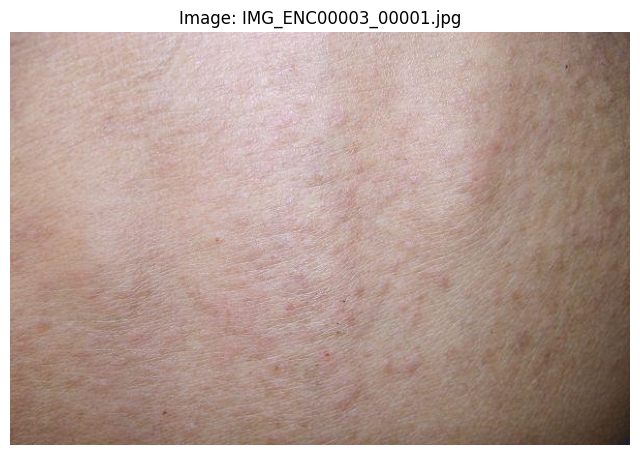


Prompt sent to Gemini:

    Based on this medical image, answer the following question:
    
    Question: 1 Where is the affected area?
    
    Valid answers: "back", "chest/abdomen"
    
    Instructions:
    1. You MUST select EXACTLY ONE answer from the list of valid answers provided above.
    2. Respond with ONLY the exact text of your selected answer - no quotes, no explanations, no additional text.
    3. Your response must match one of the valid answers exactly.
    

Sending request to Gemini API...

Raw Gemini response: back
Cleaned response: back
Response matches valid answer: back
Selected answer: back
Results: [{'encounter_id': 'ENC00003', 'base_qid': 'CQID011', 'image_id': 'IMG_ENC00003_00001.jpg', 'image_path': '/storage/coda1/p-dsgt_clef2025/0/kthakrar3/mediqa-magic-v2/2025_dataset/train/images_train/IMG_ENC00003_00001.jpg', 'valid_answers': ['back', 'chest/abdomen'], 'question_text': '1 Where is the affected area?', 'selected_answer': 'back'}]


In [40]:
# Test with just the first item
test_entry = gemini_multi_answer_data[0]  # Get the first entry as a dictionary
print("Testing with entry:", test_entry)

# Process just this one entry
selected_answer = identify_valid_answer(test_entry)
print(f"Selected answer: {selected_answer}")

# Create a single result
results = [{
    'encounter_id': test_entry['encounter_id'],
    'base_qid': test_entry['base_qid'],
    'image_id': test_entry['image_id'],
    'image_path': test_entry['image_path'],
    'valid_answers': test_entry['valid_answers'],
    'question_text': test_entry['question_text'],
    'selected_answer': selected_answer
}]

print("Results:", results)

In [44]:
def identify_valid_answer(entry):
    """
    Use Gemini to identify which valid answer applies to an image.
    
    Args:
        entry: Dictionary containing encounter_id, base_qid, image_path, question_text, and valid_answers
    
    Returns:
        Selected answer that applies to the image
    """
    
    client = genai.Client(api_key=api_key)
    
    image_path = entry['image_path']
    valid_answers = entry['valid_answers']
    question_text = entry['question_text']
    
    # Print all the inputs
#     print(f"Processing entry:")
#     print(f"Encounter ID: {entry['encounter_id']}")
#     print(f"Base QID: {entry['base_qid']}")
#     print(f"Image ID: {entry['image_id']}")
#     print(f"Image path: {image_path}")
#     print(f"Question text: {question_text}")
#     print(f"Valid answers: {valid_answers}")
    
    # Open and display the image
    image = Image.open(image_path)
    
    # Display the image
#     plt.figure(figsize=(8, 8))
#     plt.imshow(image)
#     plt.axis('off')
#     plt.title(f"Image: {entry['image_id']}")
#     plt.show()
    
    # Prepare the prompt
    prompt = f"""
    Based on this medical image, answer the following question:
    
    Question: {question_text}
    
    Valid answers: {', '.join([f'"{answer}"' for answer in valid_answers])}
    
    Instructions:
    1. You MUST select EXACTLY ONE answer from the list of valid answers provided above.
    2. Respond with ONLY the exact text of your selected answer - no quotes, no explanations, no additional text.
    3. Your response must match one of the valid answers exactly.
    """
    
#     print(f"\nPrompt sent to Gemini:")
#     print(prompt)
    
    try:
        # Process the image with Gemini
#         print("\nSending request to Gemini API...")
        response = client.models.generate_content(
            model="gemini-1.5-flash",
            contents=[prompt, image]
        )
        
        result = response.text.strip()
#         print(f"\nRaw Gemini response: {result}")
        
        # Clean the response - remove quotes if present
        result = result.strip('"\'')
#         print(f"Cleaned response: {result}")
        
        # Validate that the answer is in our valid answers list
        if result in valid_answers:
#             print(f"Response matches valid answer: {result}")
            return result
        else:
            # Try to find the closest match in valid answers
            print("Response doesn't exactly match any valid answer. Searching for closest match...")
            for answer in valid_answers:
                if answer.lower() in result.lower() or result.lower() in answer.lower():
                    print(f"Found closest match: {answer}")
                    return answer
            
            # If still no match, just return the first valid answer as a fallback
            print(f"No match found. Defaulting to first valid answer: {valid_answers[0]}")
            return valid_answers[0]
    
    except Exception as e:
        print(f"Error processing {image_path}: {e}")
        # Return the first valid answer as a fallback in case of errors
        print(f"Defaulting to first valid answer due to error: {valid_answers[0]}")
        return valid_answers[0]

In [45]:
results = []
# Use the entire list of gemini_multi_answer_data, not just the first item
for entry in tqdm(gemini_multi_answer_data, desc="Processing images with Gemini"):
    selected_answer = identify_valid_answer(entry)
    
    results.append({
        'encounter_id': entry['encounter_id'],
        'base_qid': entry['base_qid'],
        'image_id': entry['image_id'],
        'image_path': entry['image_path'],
        'valid_answers': entry['valid_answers'],
        'question_text': entry['question_text'],
        'selected_answer': selected_answer
    })

Processing images with Gemini:   0%|          | 0/613 [00:00<?, ?it/s]

Response doesn't exactly match any valid answer. Searching for closest match...
No match found. Defaulting to first valid answer: upper extremities
Response doesn't exactly match any valid answer. Searching for closest match...
Found closest match: lower extremities
Response doesn't exactly match any valid answer. Searching for closest match...
No match found. Defaulting to first valid answer: upper extremities


In [46]:
# Convert to DataFrame for easier analysis
results_df = pd.DataFrame(results)

In [47]:
results_df.head()

,encounter_id,base_qid,image_id,image_path,valid_answers,question_text,selected_answer
0,ENC00003,CQID011,IMG_ENC00003_00001.jpg,/storage/coda1/p-dsgt_clef2025/0/kthakrar3/med...,"[back, chest/abdomen]",1 Where is the affected area?,chest/abdomen
1,ENC00003,CQID011,IMG_ENC00003_00002.jpg,/storage/coda1/p-dsgt_clef2025/0/kthakrar3/med...,"[back, chest/abdomen]",1 Where is the affected area?,chest/abdomen
2,ENC00003,CQID011,IMG_ENC00003_00003.jpg,/storage/coda1/p-dsgt_clef2025/0/kthakrar3/med...,"[back, chest/abdomen]",1 Where is the affected area?,back
3,ENC00003,CQID011,IMG_ENC00003_00004.jpg,/storage/coda1/p-dsgt_clef2025/0/kthakrar3/med...,"[back, chest/abdomen]",1 Where is the affected area?,back
4,ENC00003,CQID011,IMG_ENC00003_00005.jpg,/storage/coda1/p-dsgt_clef2025/0/kthakrar3/med...,"[back, chest/abdomen]",1 Where is the affected area?,back


In [48]:
results_df.to_csv("outputs/results.csv", index=False)

In [49]:
unique_base_qids = results_df['base_qid'].unique().tolist()
print(unique_base_qids)

['CQID011', 'CQID020', 'CQID012']


In [50]:
print(len(results_df))

613


In [63]:
# Create a combined dataset with both multi-value and single-value data
# First, process single-value data
single_value_data = []

# Filter to cases with single valid answers
single_valid_answer_data = multi_question_data[multi_question_data['valid_answers'].apply(len) == 1]

In [65]:
enc00003_single_data = single_valid_answer_data[single_valid_answer_data['encounter_id'] == 'ENC00003']

print(f"Base QIDs for ENC00003 in single_valid_answer_data:")
print(enc00003_single_data['base_qid'].tolist()) 

# has 7 of 9 as 2 question families have multiple labels
# aka single_valid_answer_data creation is working as expected

Base QIDs for ENC00003 in single_valid_answer_data:
['CQID010', 'CQID012', 'CQID015', 'CQID025', 'CQID034', 'CQID035', 'CQID036']


In [70]:
single_valid_answer_data.head()

,encounter_id,base_qid,qid,question_en,answer_text,answer_index,image_ids,options_en,question_type_en,question_category_en,valid_answers
0,ENC00001,CQID010,[CQID010-001],[How much of the body is affected?],[limited area],[1],"[IMG_ENC00001_00001.jpg, IMG_ENC00001_00002.jpg]","[single spot, limited area, widespread, Not me...",Site,General,[limited area]
1,ENC00001,CQID011,"[CQID011-001, CQID011-002, CQID011-003, CQID01...","[1 Where is the affected area?, 2 Where is the...","[back, Not mentioned, Not mentioned, Not menti...","[5, 7, 7, 7, 7, 7]","[IMG_ENC00001_00001.jpg, IMG_ENC00001_00002.jpg]","[head, neck, upper extremities, lower extremit...",Site Location,General,[back]
2,ENC00001,CQID012,"[CQID012-001, CQID012-002, CQID012-003, CQID01...",[1 How large are the affected areas? Please sp...,"[size of palm, Not mentioned, Not mentioned, N...","[1, 3, 3, 3, 3, 3]","[IMG_ENC00001_00001.jpg, IMG_ENC00001_00002.jpg]","[size of thumb nail, size of palm, larger area...",Size,General,[size of palm]
3,ENC00001,CQID015,[CQID015-001],[When did the patient first notice the issue?],[Not mentioned],[6],"[IMG_ENC00001_00001.jpg, IMG_ENC00001_00002.jpg]","[within hours, within days, within weeks, with...",Onset,General,[Not mentioned]
4,ENC00001,CQID020,"[CQID020-001, CQID020-002, CQID020-003, CQID02...",[1 What label best describes the affected area...,"[thick or raised, Not mentioned, Not mentioned...","[3, 9, 9, 9, 9, 9, 9, 9, 9]","[IMG_ENC00001_00001.jpg, IMG_ENC00001_00002.jpg]","[raised or bumpy, flat, skin loss or sunken, t...",Skin Description,Skin Specific,[thick or raised]


In [51]:
for _, row in tqdm(single_valid_answer_data.iterrows(), desc="Processing single-answer data"):
    encounter_id = row['encounter_id']
    base_qid = row['base_qid']
    # The single valid answer
    valid_answer = row['valid_answers'][0]  
    image_ids = row['image_ids']
    question_text = row['question_en'][0]
    
    for img_id in image_ids:
        img_path = os.path.join(IMAGES_DIR, img_id)
        
        # Skip if image doesn't exist
        if not os.path.exists(img_path):
            continue
            
        single_value_data.append({
            'encounter_id': encounter_id,
            'base_qid': base_qid,
            'image_id': img_id,
            'image_path': img_path,
            'valid_answers': [valid_answer],
            'question_text': question_text,
            'selected_answer': valid_answer  # Just use the valid answer directly
        })

Processing single-answer data: 0it [00:00, ?it/s]

In [52]:
# Convert to DataFrame
single_value_df = pd.DataFrame(single_value_data)

In [68]:
enc00003_single_data = single_value_df[single_value_df['encounter_id'] == 'ENC00003']

print(f"Base QIDs for ENC00003 in single_valid_answer_data:")
print(enc00003_single_data['base_qid'].unique()) 

# has 7 of 9 as 2 question families have multiple labels
# aka single_value_df creation is working as expected

Base QIDs for ENC00003 in single_valid_answer_data:
['CQID010' 'CQID012' 'CQID015' 'CQID025' 'CQID034' 'CQID035' 'CQID036']


In [53]:
print(len(single_value_df))

7280


In [72]:
# Count unique combinations in single_value_df
unique_combinations = single_value_df.drop_duplicates(['encounter_id', 'base_qid', 'image_id']).shape[0]
print(f"Unique encounter-base_qid-image combinations in single_value_df: {unique_combinations}")

# Verify if this equals the total rows (checking for duplicates)
total_rows = len(single_value_df)
print(f"Total rows in single_value_df: {total_rows}")
print(f"Are they equal? {total_rows == unique_combinations}")

Unique encounter-base_qid-image combinations in single_value_df: 7280
Total rows in single_value_df: 7280
Are they equal? True


In [56]:
combined_df = pd.concat([results_df, single_value_df], ignore_index=True)

In [58]:
single_value_df.head()

,encounter_id,base_qid,image_id,image_path,valid_answers,question_text,selected_answer
0,ENC00001,CQID010,IMG_ENC00001_00001.jpg,/storage/coda1/p-dsgt_clef2025/0/kthakrar3/med...,[limited area],How much of the body is affected?,limited area
1,ENC00001,CQID010,IMG_ENC00001_00002.jpg,/storage/coda1/p-dsgt_clef2025/0/kthakrar3/med...,[limited area],How much of the body is affected?,limited area
2,ENC00001,CQID011,IMG_ENC00001_00001.jpg,/storage/coda1/p-dsgt_clef2025/0/kthakrar3/med...,[back],1 Where is the affected area?,back
3,ENC00001,CQID011,IMG_ENC00001_00002.jpg,/storage/coda1/p-dsgt_clef2025/0/kthakrar3/med...,[back],1 Where is the affected area?,back
4,ENC00001,CQID012,IMG_ENC00001_00001.jpg,/storage/coda1/p-dsgt_clef2025/0/kthakrar3/med...,[size of palm],1 How large are the affected areas? Please spe...,size of palm


In [61]:
unique_base_qids = single_value_df['base_qid'].unique().tolist()
print(unique_base_qids)

['CQID010', 'CQID011', 'CQID012', 'CQID015', 'CQID020', 'CQID025', 'CQID034', 'CQID035', 'CQID036']


In [60]:
results_df.head()

,encounter_id,base_qid,image_id,image_path,valid_answers,question_text,selected_answer
0,ENC00003,CQID011,IMG_ENC00003_00001.jpg,/storage/coda1/p-dsgt_clef2025/0/kthakrar3/med...,"[back, chest/abdomen]",1 Where is the affected area?,chest/abdomen
1,ENC00003,CQID011,IMG_ENC00003_00002.jpg,/storage/coda1/p-dsgt_clef2025/0/kthakrar3/med...,"[back, chest/abdomen]",1 Where is the affected area?,chest/abdomen
2,ENC00003,CQID011,IMG_ENC00003_00003.jpg,/storage/coda1/p-dsgt_clef2025/0/kthakrar3/med...,"[back, chest/abdomen]",1 Where is the affected area?,back
3,ENC00003,CQID011,IMG_ENC00003_00004.jpg,/storage/coda1/p-dsgt_clef2025/0/kthakrar3/med...,"[back, chest/abdomen]",1 Where is the affected area?,back
4,ENC00003,CQID011,IMG_ENC00003_00005.jpg,/storage/coda1/p-dsgt_clef2025/0/kthakrar3/med...,"[back, chest/abdomen]",1 Where is the affected area?,back


In [62]:
unique_base_qids = results_df['base_qid'].unique().tolist()
print(unique_base_qids)

['CQID011', 'CQID020', 'CQID012']


In [76]:
combined_df.head()

,encounter_id,base_qid,image_id,image_path,valid_answers,question_text,selected_answer
0,ENC00003,CQID011,IMG_ENC00003_00001.jpg,/storage/coda1/p-dsgt_clef2025/0/kthakrar3/med...,"[back, chest/abdomen]",1 Where is the affected area?,chest/abdomen
1,ENC00003,CQID011,IMG_ENC00003_00002.jpg,/storage/coda1/p-dsgt_clef2025/0/kthakrar3/med...,"[back, chest/abdomen]",1 Where is the affected area?,chest/abdomen
2,ENC00003,CQID011,IMG_ENC00003_00003.jpg,/storage/coda1/p-dsgt_clef2025/0/kthakrar3/med...,"[back, chest/abdomen]",1 Where is the affected area?,back
3,ENC00003,CQID011,IMG_ENC00003_00004.jpg,/storage/coda1/p-dsgt_clef2025/0/kthakrar3/med...,"[back, chest/abdomen]",1 Where is the affected area?,back
4,ENC00003,CQID011,IMG_ENC00003_00005.jpg,/storage/coda1/p-dsgt_clef2025/0/kthakrar3/med...,"[back, chest/abdomen]",1 Where is the affected area?,back


In [80]:
print(f"Total images in combined dataset: {len(combined_df)}")
# 877 images * 9 questions = 7893

Total images in combined dataset: 7893


In [78]:
# combined_df.to_csv("outputs/combined_dataset.csv", index=False)

In [44]:
combined_df = pd.read_csv("outputs/combined_dataset.csv")
combined_df.head()

,encounter_id,base_qid,image_id,image_path,valid_answers,question_text,selected_answer
0,ENC00003,CQID011,IMG_ENC00003_00001.jpg,/storage/coda1/p-dsgt_clef2025/0/kthakrar3/med...,"['back', 'chest/abdomen']",1 Where is the affected area?,chest/abdomen
1,ENC00003,CQID011,IMG_ENC00003_00002.jpg,/storage/coda1/p-dsgt_clef2025/0/kthakrar3/med...,"['back', 'chest/abdomen']",1 Where is the affected area?,chest/abdomen
2,ENC00003,CQID011,IMG_ENC00003_00003.jpg,/storage/coda1/p-dsgt_clef2025/0/kthakrar3/med...,"['back', 'chest/abdomen']",1 Where is the affected area?,back
3,ENC00003,CQID011,IMG_ENC00003_00004.jpg,/storage/coda1/p-dsgt_clef2025/0/kthakrar3/med...,"['back', 'chest/abdomen']",1 Where is the affected area?,back
4,ENC00003,CQID011,IMG_ENC00003_00005.jpg,/storage/coda1/p-dsgt_clef2025/0/kthakrar3/med...,"['back', 'chest/abdomen']",1 Where is the affected area?,back


In [45]:
# We need to load the train.json file to get query_title_en and query_content_en
train_json_path = os.path.join(DATASET_DIR, "train.json")
train_df = pd.read_json(train_json_path)

# Convert the train_df to include query information
query_info_df = train_df[["encounter_id", "query_title_en", "query_content_en"]]

# We need to load the questions definitions to ensure we have all the question metadata
questions_path = os.path.join(DATASET_DIR, "closedquestions_definitions_imageclef2025.json")
with open(questions_path, 'r') as f:
    questions = json.load(f)
    
# Convert to DataFrame for easier manipulation
questions_df = pd.json_normalize(questions)[["qid", "question_en", "options_en", "question_type_en", "question_category_en"]]

# Extract base_qid from qid in the questions_df to match with combined_df
questions_df['base_qid'] = questions_df['qid'].str.extract(r'(CQID\d+)')

questions_df.head()

,qid,question_en,options_en,question_type_en,question_category_en,base_qid
0,CQID010-001,How much of the body is affected?,"[single spot, limited area, widespread, Not me...",Site,General,CQID010
1,CQID011-001,1 Where is the affected area?,"[head, neck, upper extremities, lower extremit...",Site Location,General,CQID011
2,CQID011-002,2 Where is the affected area?,"[head, neck, upper extremities, lower extremit...",Site Location,General,CQID011
3,CQID011-003,3 Where is the affected area?,"[head, neck, upper extremities, lower extremit...",Site Location,General,CQID011
4,CQID011-004,4 Where is the affected area?,"[head, neck, upper extremities, lower extremit...",Site Location,General,CQID011


In [46]:
query_info_df.head()

,encounter_id,query_title_en,query_content_en
0,ENC00001,Pleural effusion accompanied by rash,A patient with pleural effusion is accompanied...
1,ENC00002,What is on the bottom of the right foot?,"The patient is a 50-year-old male, who has bee..."
2,ENC00003,Interpreting Images - Is it magical skin?,"Male, 65 years old, skin lesions as shown in t..."
3,ENC00004,Skin Disease,"Male, 15 years old, keratosis on both palms, s..."
4,ENC00005,Perifollicular atrophy?,"Young female, silver-gray dot-like atrophy spo..."


In [47]:
combined_df = combined_df.merge(query_info_df, on="encounter_id", how="left")

# For adding the other columns, we need to incorporate the questions_df
# Since combined_df already has base_qid, we can use that to merge

# First, we'll create a mapping from base_qid to options_en, question_type_en, and question_category_en
# We'll take the first occurrence of each base_qid in questions_df for this mapping
base_qid_metadata = questions_df.drop_duplicates('base_qid')[['base_qid', 'options_en', 'question_type_en', 'question_category_en']]

# Now merge this with combined_df
combined_df = combined_df.merge(base_qid_metadata, on="base_qid", how="left")

# For answer_index, we need to find the index of selected_answer in options_en
def get_answer_index(row):
    try:
        if isinstance(row['options_en'], list):
            # If options_en is already a list, use it directly
            options = row['options_en']
        else:
            # Otherwise, try to parse it (it might be a string representation of a list)
            options = eval(row['options_en'])
        
        if row['selected_answer'] in options:
            return options.index(row['selected_answer'])
        else:
            return None
    except:
        return None

# Apply the function to get answer_index
combined_df['answer_index'] = combined_df.apply(get_answer_index, axis=1)

In [48]:
len(combined_df)

7893

In [49]:
combined_df.head()

,encounter_id,base_qid,image_id,image_path,valid_answers,question_text,selected_answer,query_title_en,query_content_en,options_en,question_type_en,question_category_en,answer_index
0,ENC00003,CQID011,IMG_ENC00003_00001.jpg,/storage/coda1/p-dsgt_clef2025/0/kthakrar3/med...,"['back', 'chest/abdomen']",1 Where is the affected area?,chest/abdomen,Interpreting Images - Is it magical skin?,"Male, 65 years old, skin lesions as shown in t...","[head, neck, upper extremities, lower extremit...",Site Location,General,4
1,ENC00003,CQID011,IMG_ENC00003_00002.jpg,/storage/coda1/p-dsgt_clef2025/0/kthakrar3/med...,"['back', 'chest/abdomen']",1 Where is the affected area?,chest/abdomen,Interpreting Images - Is it magical skin?,"Male, 65 years old, skin lesions as shown in t...","[head, neck, upper extremities, lower extremit...",Site Location,General,4
2,ENC00003,CQID011,IMG_ENC00003_00003.jpg,/storage/coda1/p-dsgt_clef2025/0/kthakrar3/med...,"['back', 'chest/abdomen']",1 Where is the affected area?,back,Interpreting Images - Is it magical skin?,"Male, 65 years old, skin lesions as shown in t...","[head, neck, upper extremities, lower extremit...",Site Location,General,5
3,ENC00003,CQID011,IMG_ENC00003_00004.jpg,/storage/coda1/p-dsgt_clef2025/0/kthakrar3/med...,"['back', 'chest/abdomen']",1 Where is the affected area?,back,Interpreting Images - Is it magical skin?,"Male, 65 years old, skin lesions as shown in t...","[head, neck, upper extremities, lower extremit...",Site Location,General,5
4,ENC00003,CQID011,IMG_ENC00003_00005.jpg,/storage/coda1/p-dsgt_clef2025/0/kthakrar3/med...,"['back', 'chest/abdomen']",1 Where is the affected area?,back,Interpreting Images - Is it magical skin?,"Male, 65 years old, skin lesions as shown in t...","[head, neck, upper extremities, lower extremit...",Site Location,General,5


In [50]:
# Analyze the distribution of selected answers across all base_qids in combined_df
import re
import ast  # For safely evaluating string representations of lists

# Ensure valid_answers is properly processed as a list
def parse_valid_answers(val):
    """Convert string representation of list to actual list if needed"""
    if isinstance(val, list):
        return val  # Already a list
    if isinstance(val, str):
        try:
            # Try to safely evaluate the string as a Python literal
            return ast.literal_eval(val)
        except:
            # Fall back to simple string splitting if it's comma-separated
            return [x.strip() for x in val.strip('[]').split(',')]
    return []

# Apply the function to ensure valid_answers is a list
combined_df['valid_answers_list'] = combined_df['valid_answers'].apply(parse_valid_answers)

# Now identify entries with multiple valid answers
combined_df['has_multiple_valid'] = combined_df['valid_answers_list'].apply(lambda x: len(x) > 1)
multi_valid_df = combined_df[combined_df['has_multiple_valid']]

# Get the representative question text for each base_qid
question_text_by_base_qid = {}
for base_qid in combined_df['base_qid'].unique():
    # Get the first question text for this base_qid (removing numbering if present)
    sample_text = combined_df[combined_df['base_qid'] == base_qid]['question_text'].iloc[0]
    # Remove numbering like "1 " or "1. " at the beginning
    clean_text = re.sub(r'^\d+[\s\.]?\s*', '', sample_text)
    question_text_by_base_qid[base_qid] = clean_text

# 1. Overall distribution by base_qid
print("Distribution of data across question families:")
base_qid_counts = combined_df['base_qid'].value_counts().reset_index()
base_qid_counts.columns = ['base_qid', 'count']
base_qid_counts['question_text'] = base_qid_counts['base_qid'].map(question_text_by_base_qid)
print(base_qid_counts[['base_qid', 'question_text', 'count']])
print(f"\nTotal entries: {len(combined_df)}")

# 2. Selected answer distribution for each base_qid
print("\nDistribution of selected answers by question family:")
for base_qid in combined_df['base_qid'].unique():
    question_text = question_text_by_base_qid[base_qid]
    print(f"\n{base_qid}: {question_text}")
    
    # Get answer distribution
    answer_counts = combined_df[combined_df['base_qid'] == base_qid]['selected_answer'].value_counts()
    total = len(combined_df[combined_df['base_qid'] == base_qid])
    
    # Print counts and percentages
    for answer, count in answer_counts.items():
        percentage = (count / total) * 100
        print(f"{answer}: {count} ({percentage:.1f}%)")
    
    print(f"Total {base_qid}: {total}")

# 3. Check imbalance in multi-valid answers specifically
print("\nAnalysis of questions with multiple valid answers:")
print(f"Total entries with multiple valid answers: {len(multi_valid_df)}")

multi_valid_by_qid = multi_valid_df['base_qid'].value_counts().reset_index()
multi_valid_by_qid.columns = ['base_qid', 'count']
multi_valid_by_qid['question_text'] = multi_valid_by_qid['base_qid'].map(question_text_by_base_qid)
print("\nDistribution by question family:")
print(multi_valid_by_qid[['base_qid', 'question_text', 'count']])

# 4. For multi-valid answer cases, check how often each valid answer was selected
print("\nFor questions with multiple valid answers, how often each answer was selected:")
for base_qid in multi_valid_df['base_qid'].unique():
    question_text = question_text_by_base_qid[base_qid]
    print(f"\n{base_qid}: {question_text}")
    
    base_qid_data = multi_valid_df[multi_valid_df['base_qid'] == base_qid]
    
    # Get all possible answers for this base_qid
    all_possible_answers = set()
    for valid_answers in base_qid_data['valid_answers_list']:
        all_possible_answers.update(valid_answers)
    
    # Count how often each answer was selected
    selected_counts = base_qid_data['selected_answer'].value_counts()
    
    # Calculate what percentage of times each possible answer was selected
    total = len(base_qid_data)
    print(f"Total instances: {total}")
    
    for answer in sorted(all_possible_answers):
        count = selected_counts.get(answer, 0)
        percentage = (count / total) * 100
        print(f"{answer}: selected {count} times ({percentage:.1f}%)")

Distribution of data across question families:
  base_qid                                      question_text  count
0  CQID011                        Where is the affected area?    877
1  CQID020       What label best describes the affected area?    877
2  CQID012  How large are the affected areas? Please speci...    877
3  CQID010                  How much of the body is affected?    877
4  CQID015       When did the patient first notice the issue?    877
5  CQID025  Is there any associated itching with the skin ...    877
6  CQID034  Compared to the normal surrounding skin, what ...    877
7  CQID035                   How many skin lesions are there?    877
8  CQID036                   What is the skin lesion texture?    877

Total entries: 7893

Distribution of selected answers by question family:

CQID011: Where is the affected area?
upper extremities: 302 (34.4%)
lower extremities: 222 (25.3%)
chest/abdomen: 99 (11.3%)
head: 83 (9.5%)
back: 75 (8.6%)
other (please specify): 48 (5.

In [51]:
# Filter for rows where the selected answer is "Not mentioned"
not_mentioned_df = combined_df[combined_df['selected_answer'] == "Not mentioned"]

# Display basic information about the filtered dataframe
print(f"Total rows in combined_df: {len(combined_df)}")
print(f"Rows where selected_answer is 'Not mentioned': {len(not_mentioned_df)}")

# Calculate percentage
percentage = (len(not_mentioned_df) / len(combined_df)) * 100
print(f"Percentage of 'Not mentioned' answers: {percentage:.2f}%")

not_mentioned_df.head()

Total rows in combined_df: 7893
Rows where selected_answer is 'Not mentioned': 1366
Percentage of 'Not mentioned' answers: 17.31%


,encounter_id,base_qid,image_id,image_path,valid_answers,question_text,selected_answer,query_title_en,query_content_en,options_en,question_type_en,question_category_en,answer_index,valid_answers_list,has_multiple_valid
619,ENC00001,CQID015,IMG_ENC00001_00001.jpg,/storage/coda1/p-dsgt_clef2025/0/kthakrar3/med...,['Not mentioned'],When did the patient first notice the issue?,Not mentioned,Pleural effusion accompanied by rash,A patient with pleural effusion is accompanied...,"[within hours, within days, within weeks, with...",Onset,General,6,[Not mentioned],False
620,ENC00001,CQID015,IMG_ENC00001_00002.jpg,/storage/coda1/p-dsgt_clef2025/0/kthakrar3/med...,['Not mentioned'],When did the patient first notice the issue?,Not mentioned,Pleural effusion accompanied by rash,A patient with pleural effusion is accompanied...,"[within hours, within days, within weeks, with...",Onset,General,6,[Not mentioned],False
623,ENC00001,CQID025,IMG_ENC00001_00001.jpg,/storage/coda1/p-dsgt_clef2025/0/kthakrar3/med...,['Not mentioned'],Is there any associated itching with the skin ...,Not mentioned,Pleural effusion accompanied by rash,A patient with pleural effusion is accompanied...,"[yes, no, Not mentioned]",Itch,Skin Specific,2,[Not mentioned],False
624,ENC00001,CQID025,IMG_ENC00001_00002.jpg,/storage/coda1/p-dsgt_clef2025/0/kthakrar3/med...,['Not mentioned'],Is there any associated itching with the skin ...,Not mentioned,Pleural effusion accompanied by rash,A patient with pleural effusion is accompanied...,"[yes, no, Not mentioned]",Itch,Skin Specific,2,[Not mentioned],False
651,ENC00002,CQID025,IMG_ENC00002_00001.jpg,/storage/coda1/p-dsgt_clef2025/0/kthakrar3/med...,['Not mentioned'],Is there any associated itching with the skin ...,Not mentioned,What is on the bottom of the right foot?,"The patient is a 50-year-old male, who has bee...","[yes, no, Not mentioned]",Itch,Skin Specific,2,[Not mentioned],False


In [52]:
# Save the enhanced dataset
combined_df.to_csv("outputs/full_combined_dataset.csv", index=False)

print("Full dataset created with all required columns.")

Full dataset created with all required columns.


Encounter: ENC00034
Image ID: IMG_ENC00034_00001.jpg
Question: 1 Where is the affected area?
Answer: Not mentioned
Query Title: Case 4 today
Query Content: The patient is a 60-year-old woman who was hospitalized in the Department of Internal Medicine due to hepatitis B. She has a medical history of 15 days and had the same disease two months ago. The pain
The quality of the photos is not very good, please bear with it. Just a reminder, it's a vascular disease.


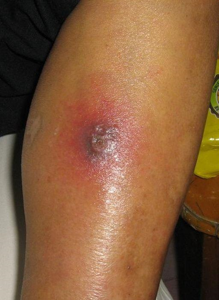

------------------------------------------------------------
Encounter: ENC00034
Image ID: IMG_ENC00034_00002.jpg
Question: 1 Where is the affected area?
Answer: Not mentioned
Query Title: Case 4 today
Query Content: The patient is a 60-year-old woman who was hospitalized in the Department of Internal Medicine due to hepatitis B. She has a medical history of 15 days and had the same disease two months ago. The pain
The quality of the photos is not very good, please bear with it. Just a reminder, it's a vascular disease.


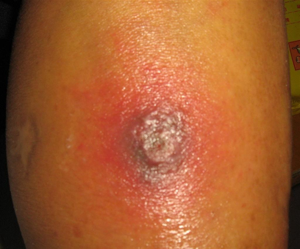

------------------------------------------------------------
Encounter: ENC00034
Image ID: IMG_ENC00034_00003.jpg
Question: 1 Where is the affected area?
Answer: Not mentioned
Query Title: Case 4 today
Query Content: The patient is a 60-year-old woman who was hospitalized in the Department of Internal Medicine due to hepatitis B. She has a medical history of 15 days and had the same disease two months ago. The pain
The quality of the photos is not very good, please bear with it. Just a reminder, it's a vascular disease.


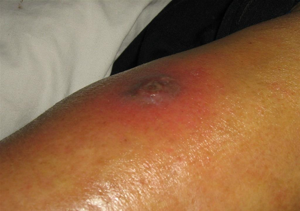

------------------------------------------------------------
Encounter: ENC00034
Image ID: IMG_ENC00034_00004.jpg
Question: 1 Where is the affected area?
Answer: Not mentioned
Query Title: Case 4 today
Query Content: The patient is a 60-year-old woman who was hospitalized in the Department of Internal Medicine due to hepatitis B. She has a medical history of 15 days and had the same disease two months ago. The pain
The quality of the photos is not very good, please bear with it. Just a reminder, it's a vascular disease.


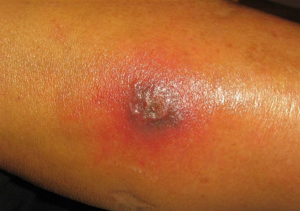

------------------------------------------------------------
Encounter: ENC00034
Image ID: IMG_ENC00034_00005.jpg
Question: 1 Where is the affected area?
Answer: Not mentioned
Query Title: Case 4 today
Query Content: The patient is a 60-year-old woman who was hospitalized in the Department of Internal Medicine due to hepatitis B. She has a medical history of 15 days and had the same disease two months ago. The pain
The quality of the photos is not very good, please bear with it. Just a reminder, it's a vascular disease.


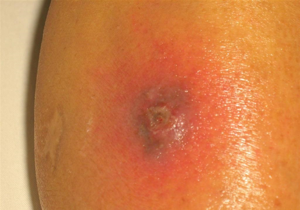

------------------------------------------------------------
Encounter: ENC00204
Image ID: IMG_ENC00204_00001.jpg
Question: 1 Where is the affected area?
Answer: Not mentioned
Query Title: Interpreting Images: Is it Erythema Centrifugum or Tinea Corporis?
Query Content: Male, 24 years old, ***skin lesions as shown in the picture for one month, no subjective feelings, and no enlargement. No similar skin lesions were found on other parts of the body. Is it erythema centrifugum or tinea corporis? Or? Thank you.


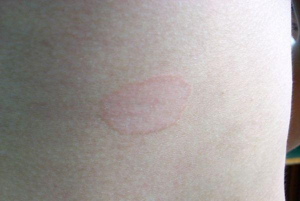

------------------------------------------------------------
Encounter: ENC00204
Image ID: IMG_ENC00204_00002.jpg
Question: 1 Where is the affected area?
Answer: Not mentioned
Query Title: Interpreting Images: Is it Erythema Centrifugum or Tinea Corporis?
Query Content: Male, 24 years old, ***skin lesions as shown in the picture for one month, no subjective feelings, and no enlargement. No similar skin lesions were found on other parts of the body. Is it erythema centrifugum or tinea corporis? Or? Thank you.


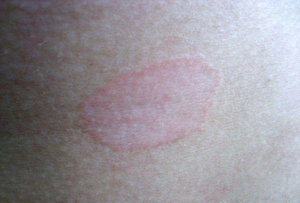

------------------------------------------------------------


In [53]:
# Filter for 'Not mentioned' in CQID011
not_mentioned_011_df = combined_df[
    (combined_df['selected_answer'] == "Not mentioned") &
    (combined_df['base_qid'] == "CQID011")
]

# Display a few results
for _, row in not_mentioned_011_df.head(15).iterrows():
    print(f"Encounter: {row['encounter_id']}")
    print(f"Image ID: {row['image_id']}")
    print(f"Question: {row['question_text']}")
    print(f"Answer: {row['selected_answer']}")
    print(f"Query Title: {row.get('query_title_en', '')}")
    print(f"Query Content: {row.get('query_content_en', '')}")
    
    try:
        image = Image.open(row['image_path'])
        image.thumbnail((300, 300))
        display(image)
    except Exception as e:
        print(f"[Error displaying image: {e}]")
    
    print("-" * 60)

Encounter: ENC00003
Image ID: IMG_ENC00003_00003.jpg
Question: 1 Where is the affected area?
Answer: back
Query Title: Interpreting Images - Is it magical skin?
Query Content: Male, 65 years old, skin lesions as shown in the picture, sometimes mild, sometimes severe for more than ten years, intense itching, regardless of day or night.


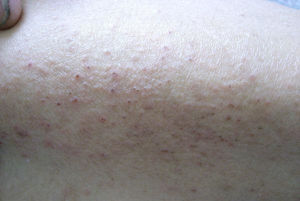

------------------------------------------------------------
Encounter: ENC00003
Image ID: IMG_ENC00003_00004.jpg
Question: 1 Where is the affected area?
Answer: back
Query Title: Interpreting Images - Is it magical skin?
Query Content: Male, 65 years old, skin lesions as shown in the picture, sometimes mild, sometimes severe for more than ten years, intense itching, regardless of day or night.


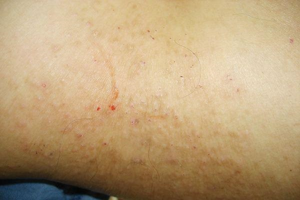

------------------------------------------------------------
Encounter: ENC00003
Image ID: IMG_ENC00003_00005.jpg
Question: 1 Where is the affected area?
Answer: back
Query Title: Interpreting Images - Is it magical skin?
Query Content: Male, 65 years old, skin lesions as shown in the picture, sometimes mild, sometimes severe for more than ten years, intense itching, regardless of day or night.


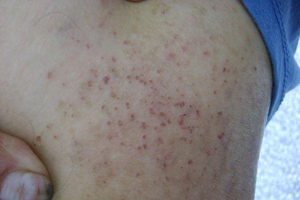

------------------------------------------------------------
Encounter: ENC00005
Image ID: IMG_ENC00005_00001.jpg
Question: 1 Where is the affected area?
Answer: back
Query Title: Perifollicular atrophy?
Query Content: Young female, silver-gray dot-like atrophy spots can be seen on the right side of the neck and back. It is unknown whether it is perifollicular atrophy.


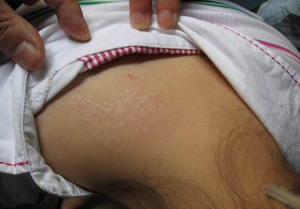

------------------------------------------------------------
Encounter: ENC00006
Image ID: IMG_ENC00006_00001.jpg
Question: 1 Where is the affected area?
Answer: back
Query Title: Can everyone diagnose what this skin disease is?
Query Content: The patient is a 50-year-old male construction worker who is frequently exposed to cement hardener. 
The first image is of the chest, and the second image is of the back. The patient has hand rashes with peeling and cracking, followed by the appearance of rashes on the chest and back, which are unbearably itchy.


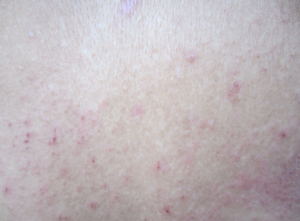

------------------------------------------------------------


In [54]:
# Filter for 'back' in CQID011
back_011_df = combined_df[
    (combined_df['selected_answer'] == "back") &
    (combined_df['base_qid'] == "CQID011")
]

# Display a few results
for _, row in back_011_df.head(5).iterrows():
    print(f"Encounter: {row['encounter_id']}")
    print(f"Image ID: {row['image_id']}")
    print(f"Question: {row['question_text']}")
    print(f"Answer: {row['selected_answer']}")
    print(f"Query Title: {row.get('query_title_en', '')}")
    print(f"Query Content: {row.get('query_content_en', '')}")
    
    try:
        image = Image.open(row['image_path'])
        image.thumbnail((300, 300))
        display(image)
    except Exception as e:
        print(f"[Error displaying image: {e}]")
    
    print("-" * 60)


Encounter: ENC00003
Image ID: IMG_ENC00003_00001.jpg
Question: 1 What label best describes the affected area?
Answer: raised or bumpy
Query Title: Interpreting Images - Is it magical skin?
Query Content: Male, 65 years old, skin lesions as shown in the picture, sometimes mild, sometimes severe for more than ten years, intense itching, regardless of day or night.


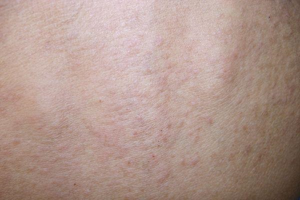

------------------------------------------------------------
Encounter: ENC00003
Image ID: IMG_ENC00003_00002.jpg
Question: 1 What label best describes the affected area?
Answer: raised or bumpy
Query Title: Interpreting Images - Is it magical skin?
Query Content: Male, 65 years old, skin lesions as shown in the picture, sometimes mild, sometimes severe for more than ten years, intense itching, regardless of day or night.


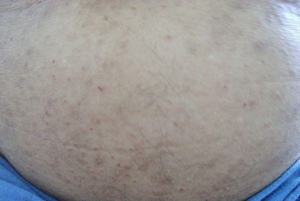

------------------------------------------------------------
Encounter: ENC00003
Image ID: IMG_ENC00003_00003.jpg
Question: 1 What label best describes the affected area?
Answer: raised or bumpy
Query Title: Interpreting Images - Is it magical skin?
Query Content: Male, 65 years old, skin lesions as shown in the picture, sometimes mild, sometimes severe for more than ten years, intense itching, regardless of day or night.


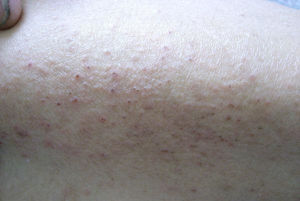

------------------------------------------------------------
Encounter: ENC00003
Image ID: IMG_ENC00003_00004.jpg
Question: 1 What label best describes the affected area?
Answer: raised or bumpy
Query Title: Interpreting Images - Is it magical skin?
Query Content: Male, 65 years old, skin lesions as shown in the picture, sometimes mild, sometimes severe for more than ten years, intense itching, regardless of day or night.


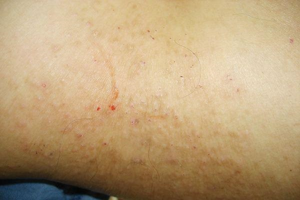

------------------------------------------------------------
Encounter: ENC00003
Image ID: IMG_ENC00003_00005.jpg
Question: 1 What label best describes the affected area?
Answer: raised or bumpy
Query Title: Interpreting Images - Is it magical skin?
Query Content: Male, 65 years old, skin lesions as shown in the picture, sometimes mild, sometimes severe for more than ten years, intense itching, regardless of day or night.


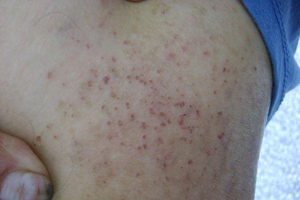

------------------------------------------------------------


In [55]:
# Filter for "raised or bumpy" answers in CQID036
raised_bumpy_020_df = combined_df[
    (combined_df['selected_answer'] == "raised or bumpy") &
    (combined_df['base_qid'] == "CQID020")
]

# Display a few examples
for _, row in raised_bumpy_020_df.head(5).iterrows():
    print(f"Encounter: {row['encounter_id']}")
    print(f"Image ID: {row['image_id']}")
    print(f"Question: {row['question_text']}")
    print(f"Answer: {row['selected_answer']}")
    print(f"Query Title: {row.get('query_title_en', '')}")
    print(f"Query Content: {row.get('query_content_en', '')}")
    
    try:
        image = Image.open(row['image_path'])
        image.thumbnail((300, 300))
        display(image)
    except Exception as e:
        print(f"[Error displaying image: {e}]")
    
    print("-" * 60)

Encounter: ENC00499
Image ID: IMG_ENC00499_00001.jpg
Question: 1 What label best describes the affected area?
Answer: raised or bumpy
Query Title: Please look at the picture.
Query Content: The patient is a 5-year-old boy. The skin lesion is raised above the skin. Patchy atrophy.


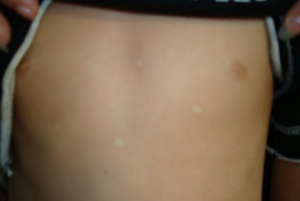

------------------------------------------------------------
Encounter: ENC00499
Image ID: IMG_ENC00499_00002.jpg
Question: 1 What label best describes the affected area?
Answer: raised or bumpy
Query Title: Please look at the picture.
Query Content: The patient is a 5-year-old boy. The skin lesion is raised above the skin. Patchy atrophy.


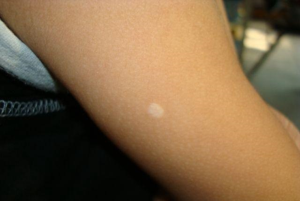

------------------------------------------------------------
Encounter: ENC00499
Image ID: IMG_ENC00499_00003.jpg
Question: 1 What label best describes the affected area?
Answer: raised or bumpy
Query Title: Please look at the picture.
Query Content: The patient is a 5-year-old boy. The skin lesion is raised above the skin. Patchy atrophy.


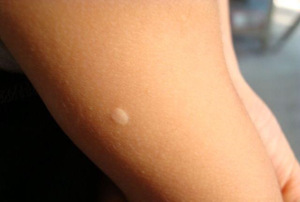

------------------------------------------------------------
Encounter: ENC00499
Image ID: IMG_ENC00499_00004.jpg
Question: 1 What label best describes the affected area?
Answer: raised or bumpy
Query Title: Please look at the picture.
Query Content: The patient is a 5-year-old boy. The skin lesion is raised above the skin. Patchy atrophy.


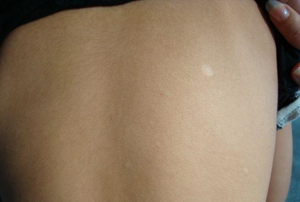

------------------------------------------------------------
Encounter: ENC00499
Image ID: IMG_ENC00499_00005.jpg
Question: 1 What label best describes the affected area?
Answer: raised or bumpy
Query Title: Please look at the picture.
Query Content: The patient is a 5-year-old boy. The skin lesion is raised above the skin. Patchy atrophy.


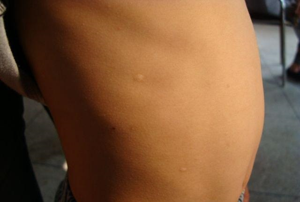

------------------------------------------------------------


In [56]:
# Filter for "raised or bumpy" answers in CQID036
raised_bumpy_020_df = combined_df[
    (combined_df['selected_answer'] == "raised or bumpy") &
    (combined_df['base_qid'] == "CQID020")
]

# Display a few examples
for _, row in raised_bumpy_020_df.tail(5).iterrows():
    print(f"Encounter: {row['encounter_id']}")
    print(f"Image ID: {row['image_id']}")
    print(f"Question: {row['question_text']}")
    print(f"Answer: {row['selected_answer']}")
    print(f"Query Title: {row.get('query_title_en', '')}")
    print(f"Query Content: {row.get('query_content_en', '')}")
    
    try:
        image = Image.open(row['image_path'])
        image.thumbnail((300, 300))
        display(image)
    except Exception as e:
        print(f"[Error displaying image: {e}]")
    
    print("-" * 60)

Encounter: ENC00314
Image ID: IMG_ENC00314_00002.jpg
Question: 1 What label best describes the affected area?
Answer: warty
Query Title: What is this disease?
Query Content: The one on the top of the head was caused by my father's naughtiness when he was a child.
But the one on the forehead only appeared recently.
Help!


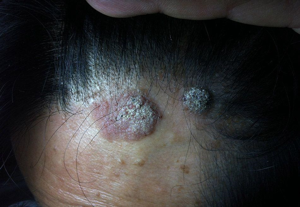

------------------------------------------------------------
Encounter: ENC00105
Image ID: IMG_ENC00105_00001.jpg
Question: 1 What label best describes the affected area?
Answer: warty
Query Title: Common Warts
Query Content: The patient reported that the current condition occurred after undergoing cryotherapy at the county hospital.


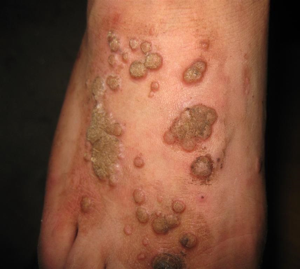

------------------------------------------------------------
Encounter: ENC00262
Image ID: IMG_ENC00262_00001.jpg
Question: 1 What label best describes the affected area?
Answer: warty
Query Title: Recently, I have been having a persistent sore throat and suspect it might be due to condyloma acuminatum.
Query Content: Recently, my throat hurts even when I don't speak, and many small flesh buds have appeared under my tongue. I suspect it's genital warts. Can anyone help me figure out what this could be? There's also a small white spot on the right side of my throat, I don't know what it is, I just discovered it recently. 
Two months ago, I was diagnosed with genital warts and am currently undergoing treatment.


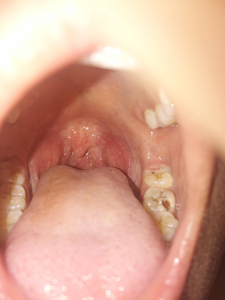

------------------------------------------------------------
Encounter: ENC00262
Image ID: IMG_ENC00262_00002.jpg
Question: 1 What label best describes the affected area?
Answer: warty
Query Title: Recently, I have been having a persistent sore throat and suspect it might be due to condyloma acuminatum.
Query Content: Recently, my throat hurts even when I don't speak, and many small flesh buds have appeared under my tongue. I suspect it's genital warts. Can anyone help me figure out what this could be? There's also a small white spot on the right side of my throat, I don't know what it is, I just discovered it recently. 
Two months ago, I was diagnosed with genital warts and am currently undergoing treatment.


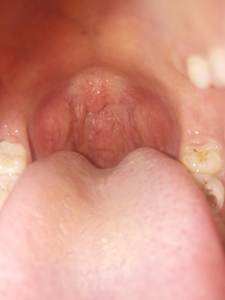

------------------------------------------------------------
Encounter: ENC00262
Image ID: IMG_ENC00262_00003.jpg
Question: 1 What label best describes the affected area?
Answer: warty
Query Title: Recently, I have been having a persistent sore throat and suspect it might be due to condyloma acuminatum.
Query Content: Recently, my throat hurts even when I don't speak, and many small flesh buds have appeared under my tongue. I suspect it's genital warts. Can anyone help me figure out what this could be? There's also a small white spot on the right side of my throat, I don't know what it is, I just discovered it recently. 
Two months ago, I was diagnosed with genital warts and am currently undergoing treatment.


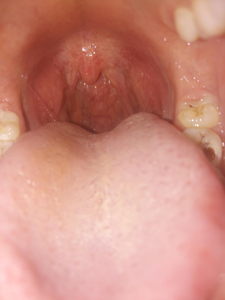

------------------------------------------------------------


In [57]:
# Filter for "raised or bumpy" answers in CQID036
warty_020_df = combined_df[
    (combined_df['selected_answer'] == "warty") &
    (combined_df['base_qid'] == "CQID020")
]

# Display a few examples
for _, row in warty_020_df.head(5).iterrows():
    print(f"Encounter: {row['encounter_id']}")
    print(f"Image ID: {row['image_id']}")
    print(f"Question: {row['question_text']}")
    print(f"Answer: {row['selected_answer']}")
    print(f"Query Title: {row.get('query_title_en', '')}")
    print(f"Query Content: {row.get('query_content_en', '')}")
    
    try:
        image = Image.open(row['image_path'])
        image.thumbnail((300, 300))
        display(image)
    except Exception as e:
        print(f"[Error displaying image: {e}]")
    
    print("-" * 60)

Encounter: ENC00036
Image ID: IMG_ENC00036_00001.jpg
Question: 1 What label best describes the affected area?
Answer: Not mentioned
Query Title: Can everyone please take a look at what's wrong with his fingernails?
Query Content: The lunula has disappeared for about three years, what I mean is that her lunula has disappeared.


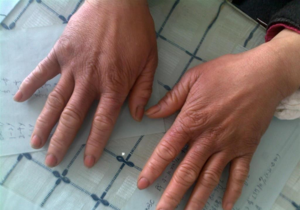

------------------------------------------------------------
Encounter: ENC00036
Image ID: IMG_ENC00036_00002.jpg
Question: 1 What label best describes the affected area?
Answer: Not mentioned
Query Title: Can everyone please take a look at what's wrong with his fingernails?
Query Content: The lunula has disappeared for about three years, what I mean is that her lunula has disappeared.


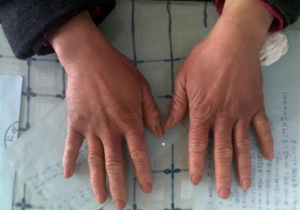

------------------------------------------------------------
Encounter: ENC00036
Image ID: IMG_ENC00036_00003.jpg
Question: 1 What label best describes the affected area?
Answer: Not mentioned
Query Title: Can everyone please take a look at what's wrong with his fingernails?
Query Content: The lunula has disappeared for about three years, what I mean is that her lunula has disappeared.


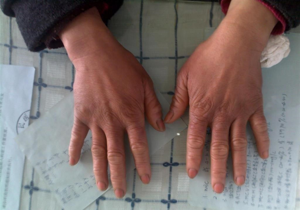

------------------------------------------------------------
Encounter: ENC00036
Image ID: IMG_ENC00036_00004.jpg
Question: 1 What label best describes the affected area?
Answer: Not mentioned
Query Title: Can everyone please take a look at what's wrong with his fingernails?
Query Content: The lunula has disappeared for about three years, what I mean is that her lunula has disappeared.


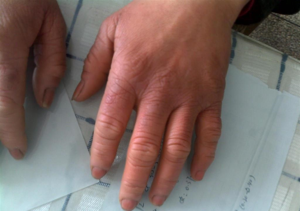

------------------------------------------------------------
Encounter: ENC00036
Image ID: IMG_ENC00036_00005.jpg
Question: 1 What label best describes the affected area?
Answer: Not mentioned
Query Title: Can everyone please take a look at what's wrong with his fingernails?
Query Content: The lunula has disappeared for about three years, what I mean is that her lunula has disappeared.


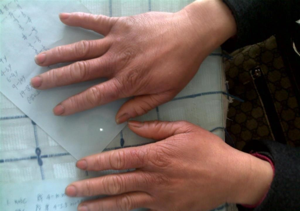

------------------------------------------------------------


In [58]:
# Filter for "raised or bumpy" answers in CQID036
not_mentioned_020_df = combined_df[
    (combined_df['selected_answer'] == "Not mentioned") &
    (combined_df['base_qid'] == "CQID020")
]

# Display a few examples
for _, row in not_mentioned_020_df.head(5).iterrows():
    print(f"Encounter: {row['encounter_id']}")
    print(f"Image ID: {row['image_id']}")
    print(f"Question: {row['question_text']}")
    print(f"Answer: {row['selected_answer']}")
    print(f"Query Title: {row.get('query_title_en', '')}")
    print(f"Query Content: {row.get('query_content_en', '')}")
    
    try:
        image = Image.open(row['image_path'])
        image.thumbnail((300, 300))
        display(image)
    except Exception as e:
        print(f"[Error displaying image: {e}]")
    
    print("-" * 60)

Encounter: ENC00194
Image ID: IMG_ENC00194_00001.jpg
Question: 1 How large are the affected areas? Please specify which affected area for each selection.
Answer: Not mentioned
Query Title: What's your diagnosis?
Query Content: The patient is a female with multiple painless hard nodules. She has been diagnosed in several hospitals with unclear results and poor treatment effects. These nodules appear in various parts of her body, including her shoulders and waist.


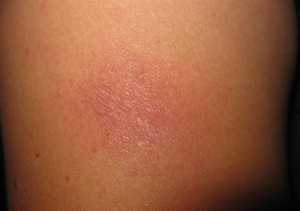

------------------------------------------------------------
Encounter: ENC00194
Image ID: IMG_ENC00194_00002.jpg
Question: 1 How large are the affected areas? Please specify which affected area for each selection.
Answer: Not mentioned
Query Title: What's your diagnosis?
Query Content: The patient is a female with multiple painless hard nodules. She has been diagnosed in several hospitals with unclear results and poor treatment effects. These nodules appear in various parts of her body, including her shoulders and waist.


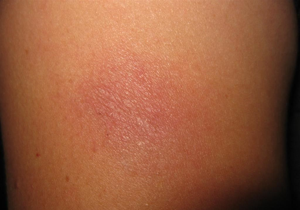

------------------------------------------------------------
Encounter: ENC00194
Image ID: IMG_ENC00194_00003.jpg
Question: 1 How large are the affected areas? Please specify which affected area for each selection.
Answer: Not mentioned
Query Title: What's your diagnosis?
Query Content: The patient is a female with multiple painless hard nodules. She has been diagnosed in several hospitals with unclear results and poor treatment effects. These nodules appear in various parts of her body, including her shoulders and waist.


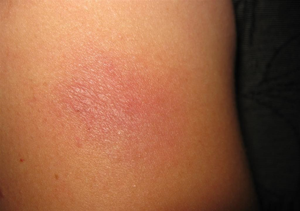

------------------------------------------------------------
Encounter: ENC00423
Image ID: IMG_ENC00423_00001.jpg
Question: 1 How large are the affected areas? Please specify which affected area for each selection.
Answer: Not mentioned
Query Title: My fingernails are suddenly receding, I'm asking for doctors to help explain this.
Query Content: Three fingernails on my right hand are separated from the nail bed, but it's not painful or itchy. It gets better in winter, but is more severe in summer. Now, the nail on the fourth finger of my left hand is starting to recede. What could be the problem? I'm seeking answers.


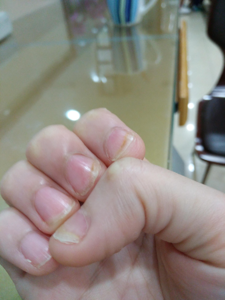

------------------------------------------------------------
Encounter: ENC00423
Image ID: IMG_ENC00423_00002.jpg
Question: 1 How large are the affected areas? Please specify which affected area for each selection.
Answer: Not mentioned
Query Title: My fingernails are suddenly receding, I'm asking for doctors to help explain this.
Query Content: Three fingernails on my right hand are separated from the nail bed, but it's not painful or itchy. It gets better in winter, but is more severe in summer. Now, the nail on the fourth finger of my left hand is starting to recede. What could be the problem? I'm seeking answers.


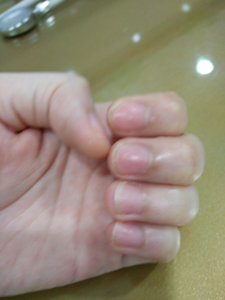

------------------------------------------------------------


In [59]:
# Filter for 'Not mentioned' in CQID015
not_mentioned_012_df = combined_df[
    (combined_df['selected_answer'] == "Not mentioned") &
    (combined_df['base_qid'] == "CQID012")
]

# Display a few results
for _, row in not_mentioned_012_df.head(5).iterrows():
    print(f"Encounter: {row['encounter_id']}")
    print(f"Image ID: {row['image_id']}")
    print(f"Question: {row['question_text']}")
    print(f"Answer: {row['selected_answer']}")
    print(f"Query Title: {row.get('query_title_en', '')}")
    print(f"Query Content: {row.get('query_content_en', '')}")
    
    try:
        image = Image.open(row['image_path'])
        image.thumbnail((300, 300))
        display(image)
    except Exception as e:
        print(f"[Error displaying image: {e}]")
    
    print("-" * 60)

Encounter: ENC00023
Image ID: IMG_ENC00023_00004.jpg
Question: 1 How large are the affected areas? Please specify which affected area for each selection.
Answer: size of palm
Query Title: Everyone, take a look at what disease this is!
Query Content: [Seeking Help and Answers] Everyone, take a look at this unfamiliar disease.
The patient is a 50-year-old male, with scattered rice-sized blisters on his face, neck, chest, back, and armpits. The blisters are not easily broken when touched and there are no symptoms such as itching. He has had diabetes for 5 years and is currently hospitalized for internal medicine treatment. Can anyone identify this disease?


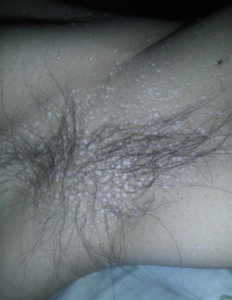

------------------------------------------------------------
Encounter: ENC00300
Image ID: IMG_ENC00300_00001.jpg
Question: 1 How large are the affected areas? Please specify which affected area for each selection.
Answer: size of palm
Query Title: Hand ringworm?
Query Content: Speak from the picture


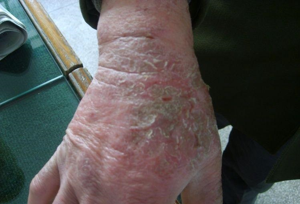

------------------------------------------------------------
Encounter: ENC00300
Image ID: IMG_ENC00300_00002.jpg
Question: 1 How large are the affected areas? Please specify which affected area for each selection.
Answer: size of palm
Query Title: Hand ringworm?
Query Content: Speak from the picture


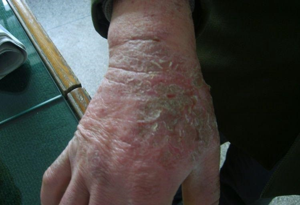

------------------------------------------------------------
Encounter: ENC00300
Image ID: IMG_ENC00300_00003.jpg
Question: 1 How large are the affected areas? Please specify which affected area for each selection.
Answer: size of palm
Query Title: Hand ringworm?
Query Content: Speak from the picture


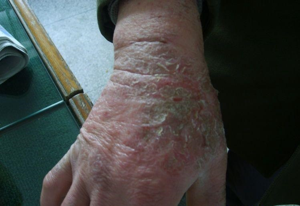

------------------------------------------------------------
Encounter: ENC00420
Image ID: IMG_ENC00420_00002.jpg
Question: 1 How large are the affected areas? Please specify which affected area for each selection.
Answer: size of palm
Query Title: Interesting clinical case, let's discuss it together.
Query Content: The patient is a young male, with skin erythema and burning pain for 1 day. The rash is shown in the picture, and it only appears on the face and hands, occurring symmetrically. On the basis of the erythema of the ear skin lesions, there are dense small vesicles, which are not itchy, but the burning sensation is more severe when exposed to heat. The patient reported that he had been diagnosed with chlamydia infection and had taken medication three days before the onset of the disease (specific medication is unknown). There is no similar medical history among the surrounding population and his family.


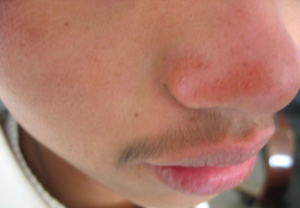

------------------------------------------------------------


In [60]:
# Filter for 'Not mentioned' in CQID015
palm_012_df = combined_df[
    (combined_df['selected_answer'] == "size of palm") &
    (combined_df['base_qid'] == "CQID012")
]

# Display a few results
for _, row in palm_012_df.head(5).iterrows():
    print(f"Encounter: {row['encounter_id']}")
    print(f"Image ID: {row['image_id']}")
    print(f"Question: {row['question_text']}")
    print(f"Answer: {row['selected_answer']}")
    print(f"Query Title: {row.get('query_title_en', '')}")
    print(f"Query Content: {row.get('query_content_en', '')}")
    
    try:
        image = Image.open(row['image_path'])
        image.thumbnail((300, 300))
        display(image)
    except Exception as e:
        print(f"[Error displaying image: {e}]")
    
    print("-" * 60)

Encounter: ENC00001
Image ID: IMG_ENC00001_00001.jpg
Question: How much of the body is affected?
Answer: limited area
Query Title: Pleural effusion accompanied by rash
Query Content: A patient with pleural effusion is accompanied by a systemic rash, as seen in the picture (currently only the back picture is available).


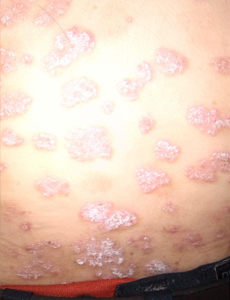

------------------------------------------------------------
Encounter: ENC00001
Image ID: IMG_ENC00001_00002.jpg
Question: How much of the body is affected?
Answer: limited area
Query Title: Pleural effusion accompanied by rash
Query Content: A patient with pleural effusion is accompanied by a systemic rash, as seen in the picture (currently only the back picture is available).


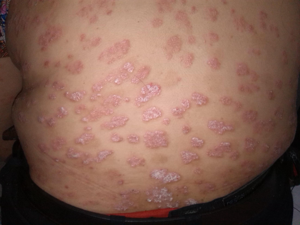

------------------------------------------------------------
Encounter: ENC00002
Image ID: IMG_ENC00002_00001.jpg
Question: How much of the body is affected?
Answer: limited area
Query Title: What is on the bottom of the right foot?
Query Content: The patient is a 50-year-old male, who has been experiencing pain in the sole of his right foot while walking for six months. Physical examination: The sole of the right foot is pale, tender to light touch, no paleness in the left foot. See the picture of the right foot above.


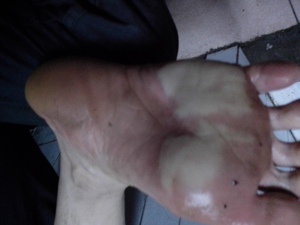

------------------------------------------------------------
Encounter: ENC00002
Image ID: IMG_ENC00002_00002.jpg
Question: How much of the body is affected?
Answer: limited area
Query Title: What is on the bottom of the right foot?
Query Content: The patient is a 50-year-old male, who has been experiencing pain in the sole of his right foot while walking for six months. Physical examination: The sole of the right foot is pale, tender to light touch, no paleness in the left foot. See the picture of the right foot above.


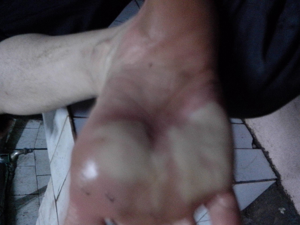

------------------------------------------------------------
Encounter: ENC00002
Image ID: IMG_ENC00002_00003.jpg
Question: How much of the body is affected?
Answer: limited area
Query Title: What is on the bottom of the right foot?
Query Content: The patient is a 50-year-old male, who has been experiencing pain in the sole of his right foot while walking for six months. Physical examination: The sole of the right foot is pale, tender to light touch, no paleness in the left foot. See the picture of the right foot above.


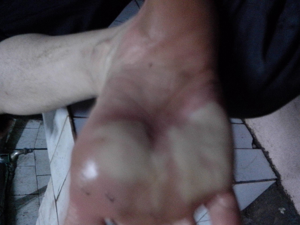

------------------------------------------------------------


In [61]:
# Filter for 'Not mentioned' in CQID015
limited_area_010_df = combined_df[
    (combined_df['selected_answer'] == "limited area") &
    (combined_df['base_qid'] == "CQID010")
]

# Display a few results
for _, row in limited_area_010_df.head(5).iterrows():
    print(f"Encounter: {row['encounter_id']}")
    print(f"Image ID: {row['image_id']}")
    print(f"Question: {row['question_text']}")
    print(f"Answer: {row['selected_answer']}")
    print(f"Query Title: {row.get('query_title_en', '')}")
    print(f"Query Content: {row.get('query_content_en', '')}")
    
    try:
        image = Image.open(row['image_path'])
        image.thumbnail((300, 300))
        display(image)
    except Exception as e:
        print(f"[Error displaying image: {e}]")
    
    print("-" * 60)

Encounter: ENC00015
Image ID: IMG_ENC00015_00001.jpg
Question: How much of the body is affected?
Answer: single spot
Query Title: Speak from the picture
Query Content: Take a look at her fingers.


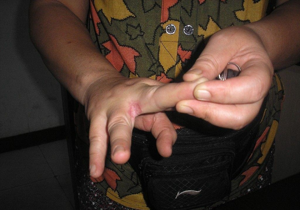

------------------------------------------------------------
Encounter: ENC00015
Image ID: IMG_ENC00015_00002.jpg
Question: How much of the body is affected?
Answer: single spot
Query Title: Speak from the picture
Query Content: Take a look at her fingers.


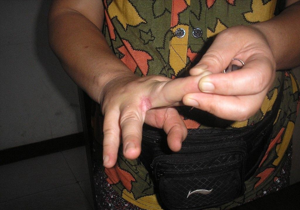

------------------------------------------------------------
Encounter: ENC00018
Image ID: IMG_ENC00018_00001.jpg
Question: How much of the body is affected?
Answer: single spot
Query Title: View image
Query Content: Female, 19 years old, has had a hard lump in her ear for three months, as hard as a wooden board, with no sense of fluctuation. After incision, a white dense substance was found. What kind of cyst could this be?


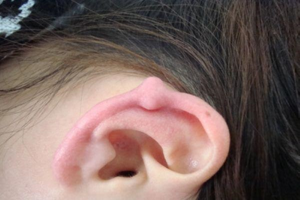

------------------------------------------------------------
Encounter: ENC00018
Image ID: IMG_ENC00018_00002.jpg
Question: How much of the body is affected?
Answer: single spot
Query Title: View image
Query Content: Female, 19 years old, has had a hard lump in her ear for three months, as hard as a wooden board, with no sense of fluctuation. After incision, a white dense substance was found. What kind of cyst could this be?


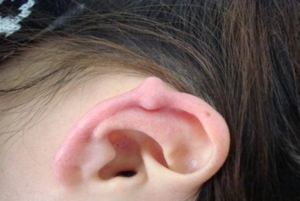

------------------------------------------------------------
Encounter: ENC00019
Image ID: IMG_ENC00019_00001.jpg
Question: How much of the body is affected?
Answer: single spot
Query Title: May I ask what kind of skin disease is this?
Query Content: There are two red spots under my armpit, they look like they have blisters on the surface, and they are very itchy. Can you tell me what this is?


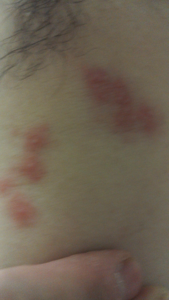

------------------------------------------------------------


In [62]:
# Filter for 'Not mentioned' in CQID015
single_spot_010_df = combined_df[
    (combined_df['selected_answer'] == "single spot") &
    (combined_df['base_qid'] == "CQID010")
]

# Display a few results
for _, row in single_spot_010_df.head(5).iterrows():
    print(f"Encounter: {row['encounter_id']}")
    print(f"Image ID: {row['image_id']}")
    print(f"Question: {row['question_text']}")
    print(f"Answer: {row['selected_answer']}")
    print(f"Query Title: {row.get('query_title_en', '')}")
    print(f"Query Content: {row.get('query_content_en', '')}")
    
    try:
        image = Image.open(row['image_path'])
        image.thumbnail((300, 300))
        display(image)
    except Exception as e:
        print(f"[Error displaying image: {e}]")
    
    print("-" * 60)

Encounter: ENC00001
Image ID: IMG_ENC00001_00001.jpg
Question: When did the patient first notice the issue?
Answer: Not mentioned
Query Title: Pleural effusion accompanied by rash
Query Content: A patient with pleural effusion is accompanied by a systemic rash, as seen in the picture (currently only the back picture is available).


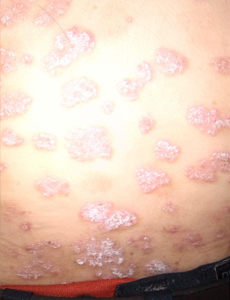

------------------------------------------------------------
Encounter: ENC00001
Image ID: IMG_ENC00001_00002.jpg
Question: When did the patient first notice the issue?
Answer: Not mentioned
Query Title: Pleural effusion accompanied by rash
Query Content: A patient with pleural effusion is accompanied by a systemic rash, as seen in the picture (currently only the back picture is available).


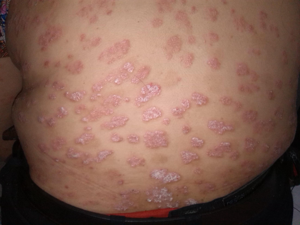

------------------------------------------------------------
Encounter: ENC00005
Image ID: IMG_ENC00005_00001.jpg
Question: When did the patient first notice the issue?
Answer: Not mentioned
Query Title: Perifollicular atrophy?
Query Content: Young female, silver-gray dot-like atrophy spots can be seen on the right side of the neck and back. It is unknown whether it is perifollicular atrophy.


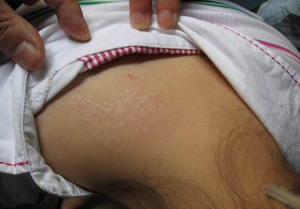

------------------------------------------------------------
Encounter: ENC00006
Image ID: IMG_ENC00006_00001.jpg
Question: When did the patient first notice the issue?
Answer: Not mentioned
Query Title: Can everyone diagnose what this skin disease is?
Query Content: The patient is a 50-year-old male construction worker who is frequently exposed to cement hardener. 
The first image is of the chest, and the second image is of the back. The patient has hand rashes with peeling and cracking, followed by the appearance of rashes on the chest and back, which are unbearably itchy.


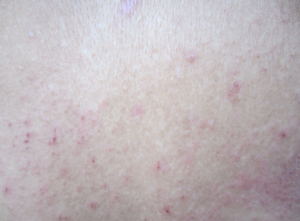

------------------------------------------------------------
Encounter: ENC00006
Image ID: IMG_ENC00006_00002.jpg
Question: When did the patient first notice the issue?
Answer: Not mentioned
Query Title: Can everyone diagnose what this skin disease is?
Query Content: The patient is a 50-year-old male construction worker who is frequently exposed to cement hardener. 
The first image is of the chest, and the second image is of the back. The patient has hand rashes with peeling and cracking, followed by the appearance of rashes on the chest and back, which are unbearably itchy.


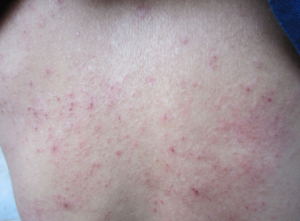

------------------------------------------------------------


In [63]:
# Filter for 'Not mentioned' in CQID015
not_mentioned_015_df = combined_df[
    (combined_df['selected_answer'] == "Not mentioned") &
    (combined_df['base_qid'] == "CQID015")
]

# Display a few results
for _, row in not_mentioned_015_df.head(5).iterrows():
    print(f"Encounter: {row['encounter_id']}")
    print(f"Image ID: {row['image_id']}")
    print(f"Question: {row['question_text']}")
    print(f"Answer: {row['selected_answer']}")
    print(f"Query Title: {row.get('query_title_en', '')}")
    print(f"Query Content: {row.get('query_content_en', '')}")
    
    try:
        image = Image.open(row['image_path'])
        image.thumbnail((300, 300))
        display(image)
    except Exception as e:
        print(f"[Error displaying image: {e}]")
    
    print("-" * 60)

Encounter: ENC00003
Image ID: IMG_ENC00003_00001.jpg
Question: When did the patient first notice the issue?
Answer: multiple years
Query Title: Interpreting Images - Is it magical skin?
Query Content: Male, 65 years old, skin lesions as shown in the picture, sometimes mild, sometimes severe for more than ten years, intense itching, regardless of day or night.


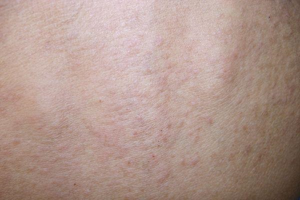

------------------------------------------------------------
Encounter: ENC00003
Image ID: IMG_ENC00003_00002.jpg
Question: When did the patient first notice the issue?
Answer: multiple years
Query Title: Interpreting Images - Is it magical skin?
Query Content: Male, 65 years old, skin lesions as shown in the picture, sometimes mild, sometimes severe for more than ten years, intense itching, regardless of day or night.


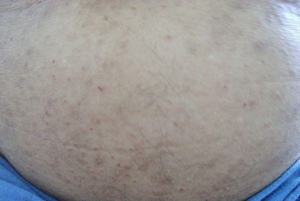

------------------------------------------------------------
Encounter: ENC00003
Image ID: IMG_ENC00003_00003.jpg
Question: When did the patient first notice the issue?
Answer: multiple years
Query Title: Interpreting Images - Is it magical skin?
Query Content: Male, 65 years old, skin lesions as shown in the picture, sometimes mild, sometimes severe for more than ten years, intense itching, regardless of day or night.


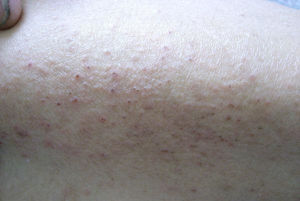

------------------------------------------------------------
Encounter: ENC00003
Image ID: IMG_ENC00003_00004.jpg
Question: When did the patient first notice the issue?
Answer: multiple years
Query Title: Interpreting Images - Is it magical skin?
Query Content: Male, 65 years old, skin lesions as shown in the picture, sometimes mild, sometimes severe for more than ten years, intense itching, regardless of day or night.


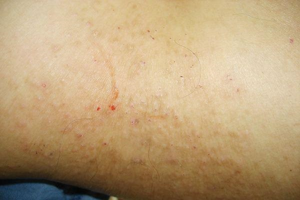

------------------------------------------------------------
Encounter: ENC00003
Image ID: IMG_ENC00003_00005.jpg
Question: When did the patient first notice the issue?
Answer: multiple years
Query Title: Interpreting Images - Is it magical skin?
Query Content: Male, 65 years old, skin lesions as shown in the picture, sometimes mild, sometimes severe for more than ten years, intense itching, regardless of day or night.


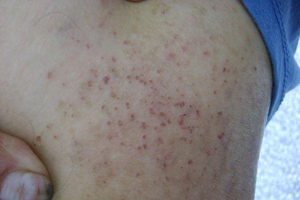

------------------------------------------------------------


In [64]:
# Filter for 'multiple years' in CQID015
multiple_years_015_df = combined_df[
    (combined_df['selected_answer'] == "multiple years") &
    (combined_df['base_qid'] == "CQID015")
]

# Display a few results
for _, row in multiple_years_015_df.head(5).iterrows():
    print(f"Encounter: {row['encounter_id']}")
    print(f"Image ID: {row['image_id']}")
    print(f"Question: {row['question_text']}")
    print(f"Answer: {row['selected_answer']}")
    print(f"Query Title: {row.get('query_title_en', '')}")
    print(f"Query Content: {row.get('query_content_en', '')}")
    
    try:
        image = Image.open(row['image_path'])
        image.thumbnail((300, 300))
        display(image)
    except Exception as e:
        print(f"[Error displaying image: {e}]")
    
    print("-" * 60)

Encounter: ENC00487
Image ID: IMG_ENC00487_00002.jpg
Question: When did the patient first notice the issue?
Answer: multiple years
Query Title: Having small red blood spots on the body for many years, what disease is this?
Query Content: I have had small red spots on my body for many years, which started when I was very young. I don't feel anything from them. My father also has some, but they tend to increase in number and size. The main issue is that they affect my appearance, especially when they appear on my face. From time to time, a new one will appear. At first, it's so small that it's not noticeable unless you look closely, but over time it becomes larger and more noticeable, which is quite frustrating.
1. What is the problem?
2. How can it be treated?
3. How can I prevent the newly appeared small spots from becoming larger and more noticeable?


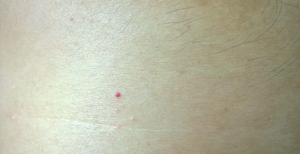

------------------------------------------------------------
Encounter: ENC00487
Image ID: IMG_ENC00487_00003.jpg
Question: When did the patient first notice the issue?
Answer: multiple years
Query Title: Having small red blood spots on the body for many years, what disease is this?
Query Content: I have had small red spots on my body for many years, which started when I was very young. I don't feel anything from them. My father also has some, but they tend to increase in number and size. The main issue is that they affect my appearance, especially when they appear on my face. From time to time, a new one will appear. At first, it's so small that it's not noticeable unless you look closely, but over time it becomes larger and more noticeable, which is quite frustrating.
1. What is the problem?
2. How can it be treated?
3. How can I prevent the newly appeared small spots from becoming larger and more noticeable?


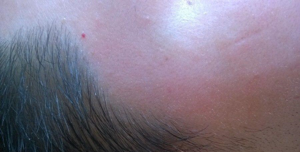

------------------------------------------------------------
Encounter: ENC00489
Image ID: IMG_ENC00489_00001.jpg
Question: When did the patient first notice the issue?
Answer: multiple years
Query Title: Take a look at this.
Query Content: Can everyone take a look at what kind of disease this is? How to treat it?
Female, 16 years old. Her mother said it was present at birth, it was small at that time, not raised above the skin, and has developed into its current state as she aged.


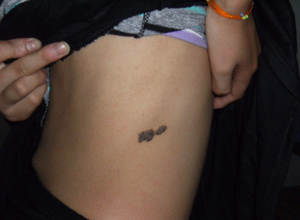

------------------------------------------------------------
Encounter: ENC00489
Image ID: IMG_ENC00489_00002.jpg
Question: When did the patient first notice the issue?
Answer: multiple years
Query Title: Take a look at this.
Query Content: Can everyone take a look at what kind of disease this is? How to treat it?
Female, 16 years old. Her mother said it was present at birth, it was small at that time, not raised above the skin, and has developed into its current state as she aged.


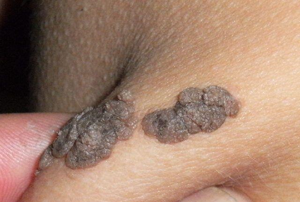

------------------------------------------------------------
Encounter: ENC00489
Image ID: IMG_ENC00489_00003.jpg
Question: When did the patient first notice the issue?
Answer: multiple years
Query Title: Take a look at this.
Query Content: Can everyone take a look at what kind of disease this is? How to treat it?
Female, 16 years old. Her mother said it was present at birth, it was small at that time, not raised above the skin, and has developed into its current state as she aged.


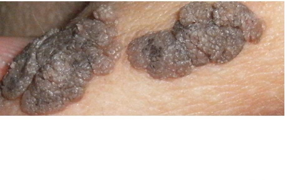

------------------------------------------------------------


In [65]:
# Filter for 'multiple years' in CQID015
multiple_years_015_df = combined_df[
    (combined_df['selected_answer'] == "multiple years") &
    (combined_df['base_qid'] == "CQID015")
]

# Display a few results
for _, row in multiple_years_015_df.tail(5).iterrows():
    print(f"Encounter: {row['encounter_id']}")
    print(f"Image ID: {row['image_id']}")
    print(f"Question: {row['question_text']}")
    print(f"Answer: {row['selected_answer']}")
    print(f"Query Title: {row.get('query_title_en', '')}")
    print(f"Query Content: {row.get('query_content_en', '')}")
    
    try:
        image = Image.open(row['image_path'])
        image.thumbnail((300, 300))
        display(image)
    except Exception as e:
        print(f"[Error displaying image: {e}]")
    
    print("-" * 60)

Encounter: ENC00033
Image ID: IMG_ENC00033_00001.jpg
Question: When did the patient first notice the issue?
Answer: within hours
Query Title: Teachers, can you help me identify what disease this is?
Query Content: I don't know when it appeared today, and it doesn't itch.


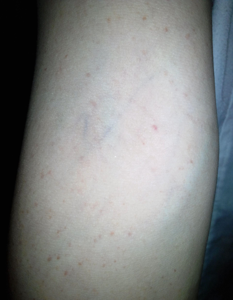

------------------------------------------------------------
Encounter: ENC00245
Image ID: IMG_ENC00245_00001.jpg
Question: When did the patient first notice the issue?
Answer: within hours
Query Title: Please, experts, diagnose based on the image.
Query Content: This morning, I felt an itch on the skin of my arm, even though I didn't come into contact with anything prickly. After scratching it a few times, some red rashes appeared. Could any experts please identify what skin disease this might be and what medication should be used for treatment? Thank you.


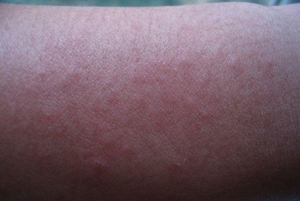

------------------------------------------------------------
Encounter: ENC00245
Image ID: IMG_ENC00245_00002.jpg
Question: When did the patient first notice the issue?
Answer: within hours
Query Title: Please, experts, diagnose based on the image.
Query Content: This morning, I felt an itch on the skin of my arm, even though I didn't come into contact with anything prickly. After scratching it a few times, some red rashes appeared. Could any experts please identify what skin disease this might be and what medication should be used for treatment? Thank you.


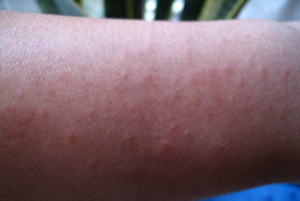

------------------------------------------------------------
Encounter: ENC00245
Image ID: IMG_ENC00245_00003.jpg
Question: When did the patient first notice the issue?
Answer: within hours
Query Title: Please, experts, diagnose based on the image.
Query Content: This morning, I felt an itch on the skin of my arm, even though I didn't come into contact with anything prickly. After scratching it a few times, some red rashes appeared. Could any experts please identify what skin disease this might be and what medication should be used for treatment? Thank you.


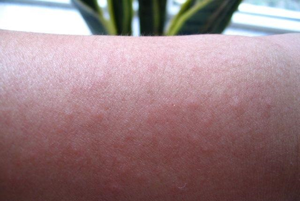

------------------------------------------------------------
Encounter: ENC00484
Image ID: IMG_ENC00484_00001.jpg
Question: When did the patient first notice the issue?
Answer: within hours
Query Title: The baby's pair of hands
Query Content: The baby's pair of hands were fine when he/she was sleeping last night. Please diagnose.


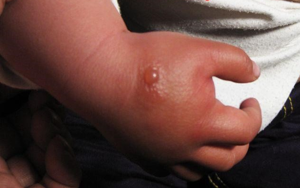

------------------------------------------------------------


In [66]:
# Filter for 'multiple years' in CQID015
within_hours_015_df = combined_df[
    (combined_df['selected_answer'] == "within hours") &
    (combined_df['base_qid'] == "CQID015")
]

# Display a few results
for _, row in within_hours_015_df.tail(5).iterrows():
    print(f"Encounter: {row['encounter_id']}")
    print(f"Image ID: {row['image_id']}")
    print(f"Question: {row['question_text']}")
    print(f"Answer: {row['selected_answer']}")
    print(f"Query Title: {row.get('query_title_en', '')}")
    print(f"Query Content: {row.get('query_content_en', '')}")
    
    try:
        image = Image.open(row['image_path'])
        image.thumbnail((300, 300))
        display(image)
    except Exception as e:
        print(f"[Error displaying image: {e}]")
    
    print("-" * 60)

Encounter: ENC00001
Image ID: IMG_ENC00001_00001.jpg
Question: Is there any associated itching with the skin problem?
Answer: Not mentioned
Query Title: Pleural effusion accompanied by rash
Query Content: A patient with pleural effusion is accompanied by a systemic rash, as seen in the picture (currently only the back picture is available).


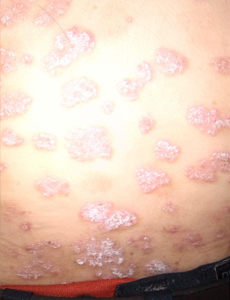

------------------------------------------------------------
Encounter: ENC00001
Image ID: IMG_ENC00001_00002.jpg
Question: Is there any associated itching with the skin problem?
Answer: Not mentioned
Query Title: Pleural effusion accompanied by rash
Query Content: A patient with pleural effusion is accompanied by a systemic rash, as seen in the picture (currently only the back picture is available).


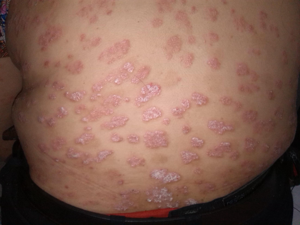

------------------------------------------------------------
Encounter: ENC00002
Image ID: IMG_ENC00002_00001.jpg
Question: Is there any associated itching with the skin problem?
Answer: Not mentioned
Query Title: What is on the bottom of the right foot?
Query Content: The patient is a 50-year-old male, who has been experiencing pain in the sole of his right foot while walking for six months. Physical examination: The sole of the right foot is pale, tender to light touch, no paleness in the left foot. See the picture of the right foot above.


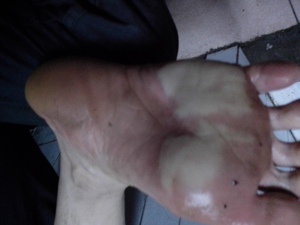

------------------------------------------------------------
Encounter: ENC00002
Image ID: IMG_ENC00002_00002.jpg
Question: Is there any associated itching with the skin problem?
Answer: Not mentioned
Query Title: What is on the bottom of the right foot?
Query Content: The patient is a 50-year-old male, who has been experiencing pain in the sole of his right foot while walking for six months. Physical examination: The sole of the right foot is pale, tender to light touch, no paleness in the left foot. See the picture of the right foot above.


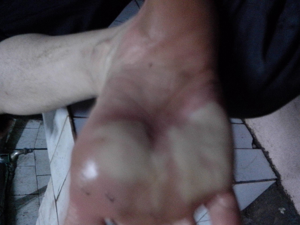

------------------------------------------------------------
Encounter: ENC00002
Image ID: IMG_ENC00002_00003.jpg
Question: Is there any associated itching with the skin problem?
Answer: Not mentioned
Query Title: What is on the bottom of the right foot?
Query Content: The patient is a 50-year-old male, who has been experiencing pain in the sole of his right foot while walking for six months. Physical examination: The sole of the right foot is pale, tender to light touch, no paleness in the left foot. See the picture of the right foot above.


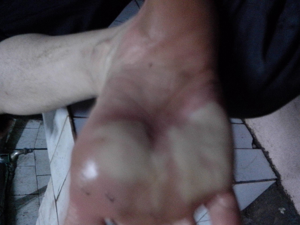

------------------------------------------------------------


In [67]:
# Filter for 'Not mentioned' in CQID025
not_mentioned_025_df = combined_df[
    (combined_df['selected_answer'] == "Not mentioned") &
    (combined_df['base_qid'] == "CQID025")
]

# Display a few results
for _, row in not_mentioned_025_df.head(5).iterrows():
    print(f"Encounter: {row['encounter_id']}")
    print(f"Image ID: {row['image_id']}")
    print(f"Question: {row['question_text']}")
    print(f"Answer: {row['selected_answer']}")
    print(f"Query Title: {row.get('query_title_en', '')}")
    print(f"Query Content: {row.get('query_content_en', '')}")
    
    try:
        image = Image.open(row['image_path'])
        image.thumbnail((300, 300))
        display(image)
    except Exception as e:
        print(f"[Error displaying image: {e}]")
    
    print("-" * 60)

Encounter: ENC00008
Image ID: IMG_ENC00008_00001.jpg
Question: Is there any associated itching with the skin problem?
Answer: no
Query Title: [Original] Today I saw a patient with a skin disease, please everyone help take a look!!!
Query Content: This patient was seen yesterday. She is a little girl, 6 years old. There is a skin lesion visible behind her right eyebrow. There is no exudation and she doesn't feel itchy, but there is slight pain. Upon examination, her temperature was 36.8. Yesterday, she was treated with Jumbizhi and Huanglian. Today, upon re-examination, another lesion has appeared behind her right ear. Upon closer inspection, it looks like there are small blister-like things, also present in her hair. I would like to ask everyone for help on how to treat this. 

Before the blisters appeared, there were no symptoms of fever, and there are no lesions on other parts of her body. The original skin lesion was not very obvious, and today's lesion is only a little bit on the o

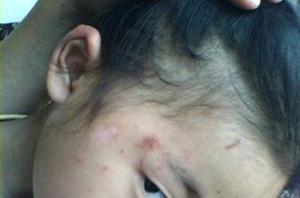

------------------------------------------------------------
Encounter: ENC00008
Image ID: IMG_ENC00008_00002.jpg
Question: Is there any associated itching with the skin problem?
Answer: no
Query Title: [Original] Today I saw a patient with a skin disease, please everyone help take a look!!!
Query Content: This patient was seen yesterday. She is a little girl, 6 years old. There is a skin lesion visible behind her right eyebrow. There is no exudation and she doesn't feel itchy, but there is slight pain. Upon examination, her temperature was 36.8. Yesterday, she was treated with Jumbizhi and Huanglian. Today, upon re-examination, another lesion has appeared behind her right ear. Upon closer inspection, it looks like there are small blister-like things, also present in her hair. I would like to ask everyone for help on how to treat this. 

Before the blisters appeared, there were no symptoms of fever, and there are no lesions on other parts of her body. The original skin lesion was not v

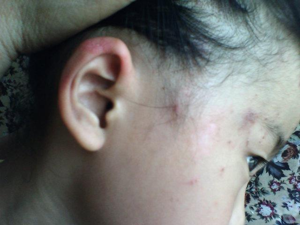

------------------------------------------------------------
Encounter: ENC00008
Image ID: IMG_ENC00008_00003.jpg
Question: Is there any associated itching with the skin problem?
Answer: no
Query Title: [Original] Today I saw a patient with a skin disease, please everyone help take a look!!!
Query Content: This patient was seen yesterday. She is a little girl, 6 years old. There is a skin lesion visible behind her right eyebrow. There is no exudation and she doesn't feel itchy, but there is slight pain. Upon examination, her temperature was 36.8. Yesterday, she was treated with Jumbizhi and Huanglian. Today, upon re-examination, another lesion has appeared behind her right ear. Upon closer inspection, it looks like there are small blister-like things, also present in her hair. I would like to ask everyone for help on how to treat this. 

Before the blisters appeared, there were no symptoms of fever, and there are no lesions on other parts of her body. The original skin lesion was not v

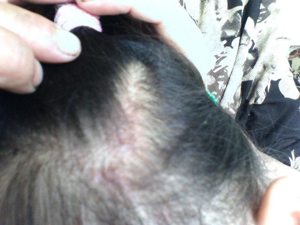

------------------------------------------------------------
Encounter: ENC00008
Image ID: IMG_ENC00008_00004.jpg
Question: Is there any associated itching with the skin problem?
Answer: no
Query Title: [Original] Today I saw a patient with a skin disease, please everyone help take a look!!!
Query Content: This patient was seen yesterday. She is a little girl, 6 years old. There is a skin lesion visible behind her right eyebrow. There is no exudation and she doesn't feel itchy, but there is slight pain. Upon examination, her temperature was 36.8. Yesterday, she was treated with Jumbizhi and Huanglian. Today, upon re-examination, another lesion has appeared behind her right ear. Upon closer inspection, it looks like there are small blister-like things, also present in her hair. I would like to ask everyone for help on how to treat this. 

Before the blisters appeared, there were no symptoms of fever, and there are no lesions on other parts of her body. The original skin lesion was not v

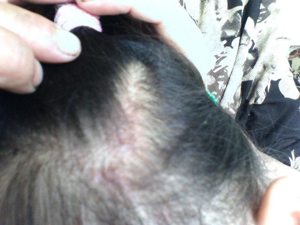

------------------------------------------------------------
Encounter: ENC00008
Image ID: IMG_ENC00008_00005.jpg
Question: Is there any associated itching with the skin problem?
Answer: no
Query Title: [Original] Today I saw a patient with a skin disease, please everyone help take a look!!!
Query Content: This patient was seen yesterday. She is a little girl, 6 years old. There is a skin lesion visible behind her right eyebrow. There is no exudation and she doesn't feel itchy, but there is slight pain. Upon examination, her temperature was 36.8. Yesterday, she was treated with Jumbizhi and Huanglian. Today, upon re-examination, another lesion has appeared behind her right ear. Upon closer inspection, it looks like there are small blister-like things, also present in her hair. I would like to ask everyone for help on how to treat this. 

Before the blisters appeared, there were no symptoms of fever, and there are no lesions on other parts of her body. The original skin lesion was not v

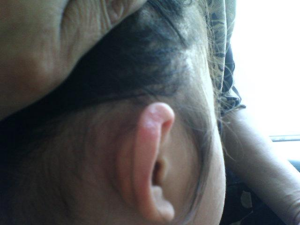

------------------------------------------------------------


In [68]:
# Filter for 'Not mentioned' in CQID025
not_025_df = combined_df[
    (combined_df['selected_answer'] == "no") &
    (combined_df['base_qid'] == "CQID025")
]

# Display a few results
for _, row in not_025_df.head(5).iterrows():
    print(f"Encounter: {row['encounter_id']}")
    print(f"Image ID: {row['image_id']}")
    print(f"Question: {row['question_text']}")
    print(f"Answer: {row['selected_answer']}")
    print(f"Query Title: {row.get('query_title_en', '')}")
    print(f"Query Content: {row.get('query_content_en', '')}")
    
    try:
        image = Image.open(row['image_path'])
        image.thumbnail((300, 300))
        display(image)
    except Exception as e:
        print(f"[Error displaying image: {e}]")
    
    print("-" * 60)

Encounter: ENC00482
Image ID: IMG_ENC00482_00005.jpg
Question: Is there any associated itching with the skin problem?
Answer: no
Query Title: Can everyone please help take a look at what's wrong with this finger?
Query Content: The patient is a 30-year-old male, who has been experiencing hardening and peeling of the skin on the fingertips for over 8 years (except for both little fingers), with no itching sensation. After peeling, he feels dry and painful. 
He has undergone medical examinations to rule out fungal infections. Oral and topical treatments have been ineffective. The peeling of the skin on the fingertips is not affected by seasonal changes. 
The peeling condition varies, with no other symptoms. 
He is asking for help to identify what this condition might be and if there are any effective treatments.


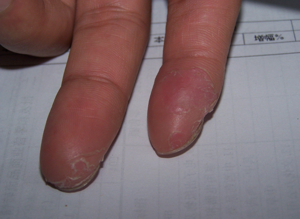

------------------------------------------------------------
Encounter: ENC00482
Image ID: IMG_ENC00482_00006.jpg
Question: Is there any associated itching with the skin problem?
Answer: no
Query Title: Can everyone please help take a look at what's wrong with this finger?
Query Content: The patient is a 30-year-old male, who has been experiencing hardening and peeling of the skin on the fingertips for over 8 years (except for both little fingers), with no itching sensation. After peeling, he feels dry and painful. 
He has undergone medical examinations to rule out fungal infections. Oral and topical treatments have been ineffective. The peeling of the skin on the fingertips is not affected by seasonal changes. 
The peeling condition varies, with no other symptoms. 
He is asking for help to identify what this condition might be and if there are any effective treatments.


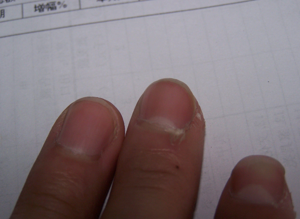

------------------------------------------------------------
Encounter: ENC00482
Image ID: IMG_ENC00482_00007.jpg
Question: Is there any associated itching with the skin problem?
Answer: no
Query Title: Can everyone please help take a look at what's wrong with this finger?
Query Content: The patient is a 30-year-old male, who has been experiencing hardening and peeling of the skin on the fingertips for over 8 years (except for both little fingers), with no itching sensation. After peeling, he feels dry and painful. 
He has undergone medical examinations to rule out fungal infections. Oral and topical treatments have been ineffective. The peeling of the skin on the fingertips is not affected by seasonal changes. 
The peeling condition varies, with no other symptoms. 
He is asking for help to identify what this condition might be and if there are any effective treatments.


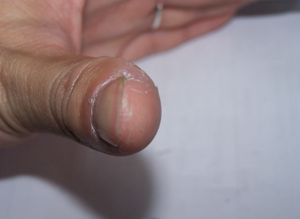

------------------------------------------------------------
Encounter: ENC00496
Image ID: IMG_ENC00496_00001.jpg
Question: Is there any associated itching with the skin problem?
Answer: no
Query Title: Waiting online, can you help me see what it is?
Query Content: No pain, no itch, and no discomfort, but there are some on the chest and waist. Now my wife also has them! What should we do?


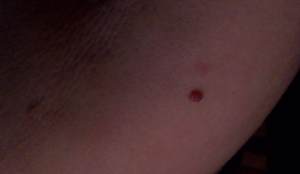

------------------------------------------------------------
Encounter: ENC00496
Image ID: IMG_ENC00496_00002.jpg
Question: Is there any associated itching with the skin problem?
Answer: no
Query Title: Waiting online, can you help me see what it is?
Query Content: No pain, no itch, and no discomfort, but there are some on the chest and waist. Now my wife also has them! What should we do?


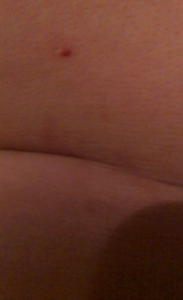

------------------------------------------------------------


In [69]:
# Filter for 'Not mentioned' in CQID025
not_025_df = combined_df[
    (combined_df['selected_answer'] == "no") &
    (combined_df['base_qid'] == "CQID025")
]

# Display a few results
for _, row in not_025_df.tail(5).iterrows():
    print(f"Encounter: {row['encounter_id']}")
    print(f"Image ID: {row['image_id']}")
    print(f"Question: {row['question_text']}")
    print(f"Answer: {row['selected_answer']}")
    print(f"Query Title: {row.get('query_title_en', '')}")
    print(f"Query Content: {row.get('query_content_en', '')}")
    
    try:
        image = Image.open(row['image_path'])
        image.thumbnail((300, 300))
        display(image)
    except Exception as e:
        print(f"[Error displaying image: {e}]")
    
    print("-" * 60)

Encounter: ENC00497
Image ID: IMG_ENC00497_00002.jpg
Question: Is there any associated itching with the skin problem?
Answer: yes
Query Title: May I ask everyone!
Query Content: May I ask everyone how to diagnose this? The patient has a history of occasional itching for a year.


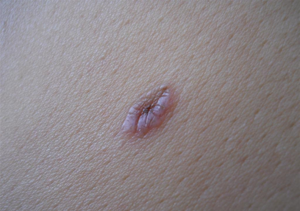

------------------------------------------------------------
Encounter: ENC00497
Image ID: IMG_ENC00497_00003.jpg
Question: Is there any associated itching with the skin problem?
Answer: yes
Query Title: May I ask everyone!
Query Content: May I ask everyone how to diagnose this? The patient has a history of occasional itching for a year.


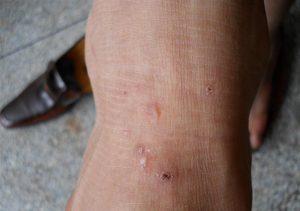

------------------------------------------------------------
Encounter: ENC00497
Image ID: IMG_ENC00497_00004.jpg
Question: Is there any associated itching with the skin problem?
Answer: yes
Query Title: May I ask everyone!
Query Content: May I ask everyone how to diagnose this? The patient has a history of occasional itching for a year.


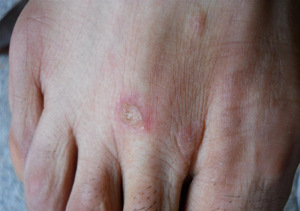

------------------------------------------------------------
Encounter: ENC00497
Image ID: IMG_ENC00497_00005.jpg
Question: Is there any associated itching with the skin problem?
Answer: yes
Query Title: May I ask everyone!
Query Content: May I ask everyone how to diagnose this? The patient has a history of occasional itching for a year.


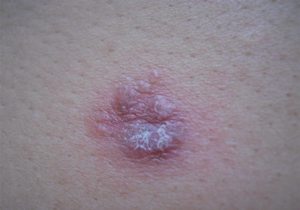

------------------------------------------------------------
Encounter: ENC00497
Image ID: IMG_ENC00497_00006.jpg
Question: Is there any associated itching with the skin problem?
Answer: yes
Query Title: May I ask everyone!
Query Content: May I ask everyone how to diagnose this? The patient has a history of occasional itching for a year.


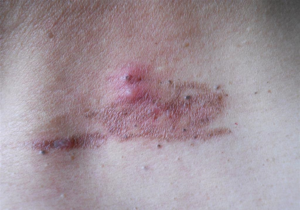

------------------------------------------------------------


In [70]:
# Filter for answers other than 'Not mentioned' in CQID025
mentioned_025_df = combined_df[
    (combined_df['selected_answer'] != "Not mentioned") &
    (combined_df['base_qid'] == "CQID025")
]

# Display a few results
for _, row in mentioned_025_df.tail(5).iterrows():
    print(f"Encounter: {row['encounter_id']}")
    print(f"Image ID: {row['image_id']}")
    print(f"Question: {row['question_text']}")
    print(f"Answer: {row['selected_answer']}")
    print(f"Query Title: {row.get('query_title_en', '')}")
    print(f"Query Content: {row.get('query_content_en', '')}")
    
    try:
        image = Image.open(row['image_path'])
        image.thumbnail((300, 300))
        display(image)
    except Exception as e:
        print(f"[Error displaying image: {e}]")
    
    print("-" * 60)

Encounter: ENC00036
Image ID: IMG_ENC00036_00001.jpg
Question: Compared to the normal surrounding skin, what is the color of the skin lesion?
Answer: Not mentioned
Query Title: Can everyone please take a look at what's wrong with his fingernails?
Query Content: The lunula has disappeared for about three years, what I mean is that her lunula has disappeared.


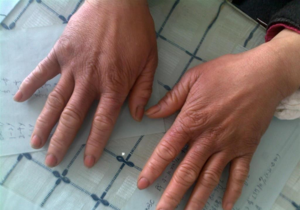

------------------------------------------------------------
Encounter: ENC00036
Image ID: IMG_ENC00036_00002.jpg
Question: Compared to the normal surrounding skin, what is the color of the skin lesion?
Answer: Not mentioned
Query Title: Can everyone please take a look at what's wrong with his fingernails?
Query Content: The lunula has disappeared for about three years, what I mean is that her lunula has disappeared.


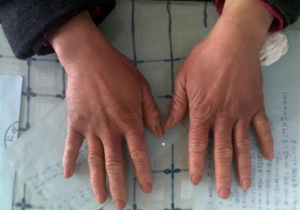

------------------------------------------------------------
Encounter: ENC00036
Image ID: IMG_ENC00036_00003.jpg
Question: Compared to the normal surrounding skin, what is the color of the skin lesion?
Answer: Not mentioned
Query Title: Can everyone please take a look at what's wrong with his fingernails?
Query Content: The lunula has disappeared for about three years, what I mean is that her lunula has disappeared.


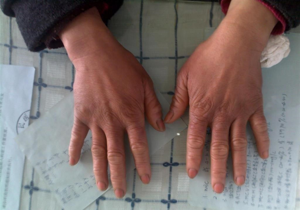

------------------------------------------------------------
Encounter: ENC00036
Image ID: IMG_ENC00036_00004.jpg
Question: Compared to the normal surrounding skin, what is the color of the skin lesion?
Answer: Not mentioned
Query Title: Can everyone please take a look at what's wrong with his fingernails?
Query Content: The lunula has disappeared for about three years, what I mean is that her lunula has disappeared.


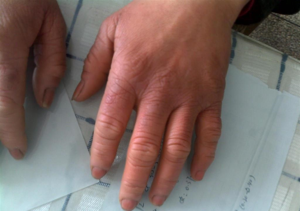

------------------------------------------------------------
Encounter: ENC00036
Image ID: IMG_ENC00036_00005.jpg
Question: Compared to the normal surrounding skin, what is the color of the skin lesion?
Answer: Not mentioned
Query Title: Can everyone please take a look at what's wrong with his fingernails?
Query Content: The lunula has disappeared for about three years, what I mean is that her lunula has disappeared.


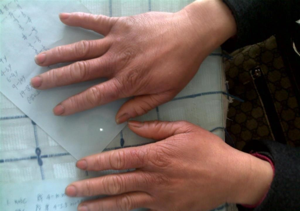

------------------------------------------------------------


In [71]:
# Filter for 'Not mentioned' in CQID034
not_mentioned_034_df = combined_df[
    (combined_df['selected_answer'] == "Not mentioned") &
    (combined_df['base_qid'] == "CQID034")
]

# Display a few examples
for _, row in not_mentioned_034_df.head(5).iterrows():
    print(f"Encounter: {row['encounter_id']}")
    print(f"Image ID: {row['image_id']}")
    print(f"Question: {row['question_text']}")
    print(f"Answer: {row['selected_answer']}")
    print(f"Query Title: {row.get('query_title_en', '')}")
    print(f"Query Content: {row.get('query_content_en', '')}")
    
    try:
        image = Image.open(row['image_path'])
        image.thumbnail((300, 300))
        display(image)
    except Exception as e:
        print(f"[Error displaying image: {e}]")
    
    print("-" * 60)

Encounter: ENC00001
Image ID: IMG_ENC00001_00001.jpg
Question: Compared to the normal surrounding skin, what is the color of the skin lesion?
Answer: combination (please specify)
Query Title: Pleural effusion accompanied by rash
Query Content: A patient with pleural effusion is accompanied by a systemic rash, as seen in the picture (currently only the back picture is available).


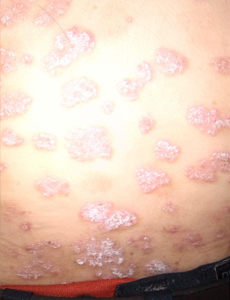

------------------------------------------------------------
Encounter: ENC00001
Image ID: IMG_ENC00001_00002.jpg
Question: Compared to the normal surrounding skin, what is the color of the skin lesion?
Answer: combination (please specify)
Query Title: Pleural effusion accompanied by rash
Query Content: A patient with pleural effusion is accompanied by a systemic rash, as seen in the picture (currently only the back picture is available).


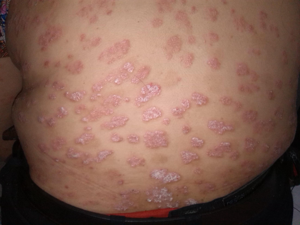

------------------------------------------------------------
Encounter: ENC00002
Image ID: IMG_ENC00002_00001.jpg
Question: Compared to the normal surrounding skin, what is the color of the skin lesion?
Answer: hypopigmentation
Query Title: What is on the bottom of the right foot?
Query Content: The patient is a 50-year-old male, who has been experiencing pain in the sole of his right foot while walking for six months. Physical examination: The sole of the right foot is pale, tender to light touch, no paleness in the left foot. See the picture of the right foot above.


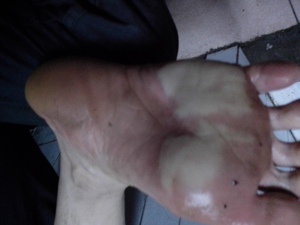

------------------------------------------------------------
Encounter: ENC00002
Image ID: IMG_ENC00002_00002.jpg
Question: Compared to the normal surrounding skin, what is the color of the skin lesion?
Answer: hypopigmentation
Query Title: What is on the bottom of the right foot?
Query Content: The patient is a 50-year-old male, who has been experiencing pain in the sole of his right foot while walking for six months. Physical examination: The sole of the right foot is pale, tender to light touch, no paleness in the left foot. See the picture of the right foot above.


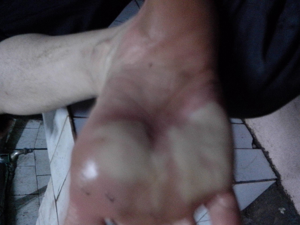

------------------------------------------------------------
Encounter: ENC00002
Image ID: IMG_ENC00002_00003.jpg
Question: Compared to the normal surrounding skin, what is the color of the skin lesion?
Answer: hypopigmentation
Query Title: What is on the bottom of the right foot?
Query Content: The patient is a 50-year-old male, who has been experiencing pain in the sole of his right foot while walking for six months. Physical examination: The sole of the right foot is pale, tender to light touch, no paleness in the left foot. See the picture of the right foot above.


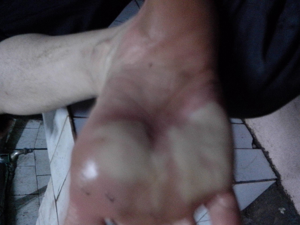

------------------------------------------------------------


In [72]:
# Filter for answers other than 'Not mentioned' in CQID034
mentioned_034_df = combined_df[
    (combined_df['selected_answer'] != "Not mentioned") &
    (combined_df['base_qid'] == "CQID034")
]

# Display a few examples
for _, row in mentioned_034_df.head(5).iterrows():
    print(f"Encounter: {row['encounter_id']}")
    print(f"Image ID: {row['image_id']}")
    print(f"Question: {row['question_text']}")
    print(f"Answer: {row['selected_answer']}")
    print(f"Query Title: {row.get('query_title_en', '')}")
    print(f"Query Content: {row.get('query_content_en', '')}")
    
    try:
        image = Image.open(row['image_path'])
        image.thumbnail((300, 300))
        display(image)
    except Exception as e:
        print(f"[Error displaying image: {e}]")
    
    print("-" * 60)

Encounter: ENC00004
Image ID: IMG_ENC00004_00001.jpg
Question: Compared to the normal surrounding skin, what is the color of the skin lesion?
Answer: red
Query Title: Skin Disease
Query Content: Male, 15 years old, keratosis on both palms, soles, and dorsum of feet, erythema for four years. No suspicious rashes observed on other parts.


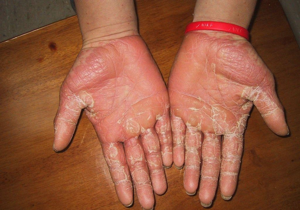

------------------------------------------------------------
Encounter: ENC00004
Image ID: IMG_ENC00004_00002.jpg
Question: Compared to the normal surrounding skin, what is the color of the skin lesion?
Answer: red
Query Title: Skin Disease
Query Content: Male, 15 years old, keratosis on both palms, soles, and dorsum of feet, erythema for four years. No suspicious rashes observed on other parts.


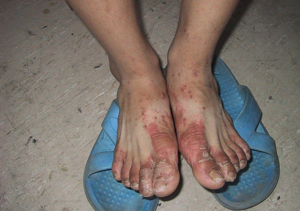

------------------------------------------------------------
Encounter: ENC00007
Image ID: IMG_ENC00007_00001.jpg
Question: Compared to the normal surrounding skin, what is the color of the skin lesion?
Answer: red
Query Title: Back is red, swollen and itchy.
Query Content: The patient is a 19-year-old male who has been experiencing redness, swelling, and itching on his back at night (as shown in the picture) for about three years. He has severe acne on his face, which extends to his neck. He usually likes to eat spicy food. 
What is this disease? 
How is it treated?


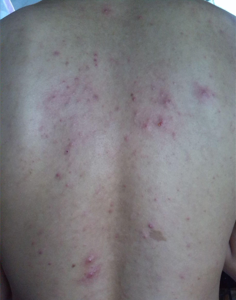

------------------------------------------------------------
Encounter: ENC00007
Image ID: IMG_ENC00007_00002.jpg
Question: Compared to the normal surrounding skin, what is the color of the skin lesion?
Answer: red
Query Title: Back is red, swollen and itchy.
Query Content: The patient is a 19-year-old male who has been experiencing redness, swelling, and itching on his back at night (as shown in the picture) for about three years. He has severe acne on his face, which extends to his neck. He usually likes to eat spicy food. 
What is this disease? 
How is it treated?


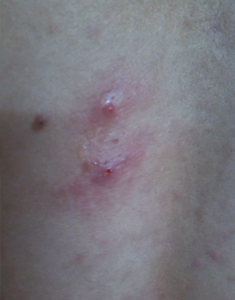

------------------------------------------------------------
Encounter: ENC00007
Image ID: IMG_ENC00007_00003.jpg
Question: Compared to the normal surrounding skin, what is the color of the skin lesion?
Answer: red
Query Title: Back is red, swollen and itchy.
Query Content: The patient is a 19-year-old male who has been experiencing redness, swelling, and itching on his back at night (as shown in the picture) for about three years. He has severe acne on his face, which extends to his neck. He usually likes to eat spicy food. 
What is this disease? 
How is it treated?


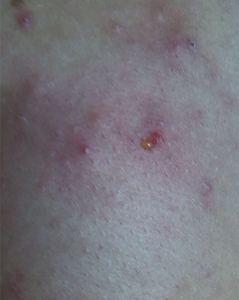

------------------------------------------------------------


In [73]:
# Filter for answers other than 'Not mentioned' in CQID034
red_034_df = combined_df[
    (combined_df['selected_answer'] == "red") &
    (combined_df['base_qid'] == "CQID034")
]

# Display a few examples
for _, row in red_034_df.head(5).iterrows():
    print(f"Encounter: {row['encounter_id']}")
    print(f"Image ID: {row['image_id']}")
    print(f"Question: {row['question_text']}")
    print(f"Answer: {row['selected_answer']}")
    print(f"Query Title: {row.get('query_title_en', '')}")
    print(f"Query Content: {row.get('query_content_en', '')}")
    
    try:
        image = Image.open(row['image_path'])
        image.thumbnail((300, 300))
        display(image)
    except Exception as e:
        print(f"[Error displaying image: {e}]")
    
    print("-" * 60)

Encounter: ENC00254
Image ID: IMG_ENC00254_00001.jpg
Question: Compared to the normal surrounding skin, what is the color of the skin lesion?
Answer: black
Query Title: Is this pilonidal sinus? What are the treatment methods?
Query Content: Originally, there were many blackheads and acne in the pores for many years. After using exfoliating cream, the number of blackheads on the nose decreased, but the pores became larger. Half a year ago, I noticed black spots in the pores, which were different in color from ordinary blackheads. I didn't pay attention to it and continued to use the exfoliating cream. Today, I found small black hairs growing in the pores, with more than five in a cluster. There are also many large pores on my face, with black hairs in the pores, which are much thicker than the usual facial fluff. As a tough girl who doesn't usually look in the mirror, I almost cried when I looked today. I need help. I live in a very remote place with no dermatology department. The docto

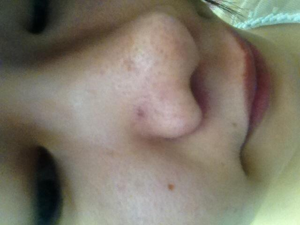

------------------------------------------------------------
Encounter: ENC00254
Image ID: IMG_ENC00254_00002.jpg
Question: Compared to the normal surrounding skin, what is the color of the skin lesion?
Answer: black
Query Title: Is this pilonidal sinus? What are the treatment methods?
Query Content: Originally, there were many blackheads and acne in the pores for many years. After using exfoliating cream, the number of blackheads on the nose decreased, but the pores became larger. Half a year ago, I noticed black spots in the pores, which were different in color from ordinary blackheads. I didn't pay attention to it and continued to use the exfoliating cream. Today, I found small black hairs growing in the pores, with more than five in a cluster. There are also many large pores on my face, with black hairs in the pores, which are much thicker than the usual facial fluff. As a tough girl who doesn't usually look in the mirror, I almost cried when I looked today. I need help. I live in 

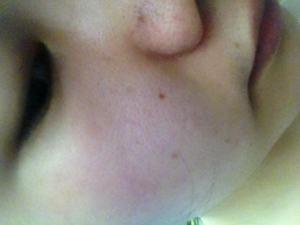

------------------------------------------------------------


In [74]:
# Filter for answers other than 'Not mentioned' in CQID034
black_034_df = combined_df[
    (combined_df['selected_answer'] == "black") &
    (combined_df['base_qid'] == "CQID034")
]

# Display a few examples
for _, row in black_034_df.head(5).iterrows():
    print(f"Encounter: {row['encounter_id']}")
    print(f"Image ID: {row['image_id']}")
    print(f"Question: {row['question_text']}")
    print(f"Answer: {row['selected_answer']}")
    print(f"Query Title: {row.get('query_title_en', '')}")
    print(f"Query Content: {row.get('query_content_en', '')}")
    
    try:
        image = Image.open(row['image_path'])
        image.thumbnail((300, 300))
        display(image)
    except Exception as e:
        print(f"[Error displaying image: {e}]")
    
    print("-" * 60)

Encounter: ENC00008
Image ID: IMG_ENC00008_00001.jpg
Question: How many skin lesions are there?
Answer: Not mentioned
Query Title: [Original] Today I saw a patient with a skin disease, please everyone help take a look!!!
Query Content: This patient was seen yesterday. She is a little girl, 6 years old. There is a skin lesion visible behind her right eyebrow. There is no exudation and she doesn't feel itchy, but there is slight pain. Upon examination, her temperature was 36.8. Yesterday, she was treated with Jumbizhi and Huanglian. Today, upon re-examination, another lesion has appeared behind her right ear. Upon closer inspection, it looks like there are small blister-like things, also present in her hair. I would like to ask everyone for help on how to treat this. 

Before the blisters appeared, there were no symptoms of fever, and there are no lesions on other parts of her body. The original skin lesion was not very obvious, and today's lesion is only a little bit on the outer ear, l

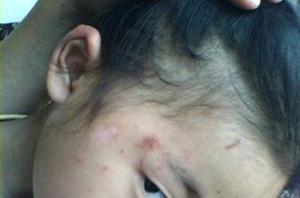

------------------------------------------------------------
Encounter: ENC00008
Image ID: IMG_ENC00008_00002.jpg
Question: How many skin lesions are there?
Answer: Not mentioned
Query Title: [Original] Today I saw a patient with a skin disease, please everyone help take a look!!!
Query Content: This patient was seen yesterday. She is a little girl, 6 years old. There is a skin lesion visible behind her right eyebrow. There is no exudation and she doesn't feel itchy, but there is slight pain. Upon examination, her temperature was 36.8. Yesterday, she was treated with Jumbizhi and Huanglian. Today, upon re-examination, another lesion has appeared behind her right ear. Upon closer inspection, it looks like there are small blister-like things, also present in her hair. I would like to ask everyone for help on how to treat this. 

Before the blisters appeared, there were no symptoms of fever, and there are no lesions on other parts of her body. The original skin lesion was not very obvious

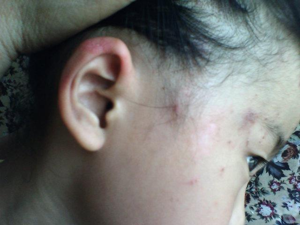

------------------------------------------------------------
Encounter: ENC00008
Image ID: IMG_ENC00008_00003.jpg
Question: How many skin lesions are there?
Answer: Not mentioned
Query Title: [Original] Today I saw a patient with a skin disease, please everyone help take a look!!!
Query Content: This patient was seen yesterday. She is a little girl, 6 years old. There is a skin lesion visible behind her right eyebrow. There is no exudation and she doesn't feel itchy, but there is slight pain. Upon examination, her temperature was 36.8. Yesterday, she was treated with Jumbizhi and Huanglian. Today, upon re-examination, another lesion has appeared behind her right ear. Upon closer inspection, it looks like there are small blister-like things, also present in her hair. I would like to ask everyone for help on how to treat this. 

Before the blisters appeared, there were no symptoms of fever, and there are no lesions on other parts of her body. The original skin lesion was not very obvious

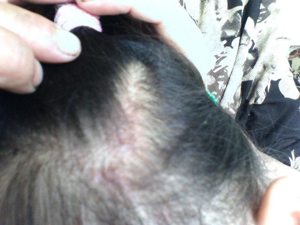

------------------------------------------------------------
Encounter: ENC00008
Image ID: IMG_ENC00008_00004.jpg
Question: How many skin lesions are there?
Answer: Not mentioned
Query Title: [Original] Today I saw a patient with a skin disease, please everyone help take a look!!!
Query Content: This patient was seen yesterday. She is a little girl, 6 years old. There is a skin lesion visible behind her right eyebrow. There is no exudation and she doesn't feel itchy, but there is slight pain. Upon examination, her temperature was 36.8. Yesterday, she was treated with Jumbizhi and Huanglian. Today, upon re-examination, another lesion has appeared behind her right ear. Upon closer inspection, it looks like there are small blister-like things, also present in her hair. I would like to ask everyone for help on how to treat this. 

Before the blisters appeared, there were no symptoms of fever, and there are no lesions on other parts of her body. The original skin lesion was not very obvious

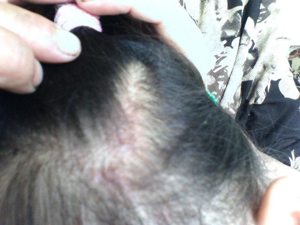

------------------------------------------------------------
Encounter: ENC00008
Image ID: IMG_ENC00008_00005.jpg
Question: How many skin lesions are there?
Answer: Not mentioned
Query Title: [Original] Today I saw a patient with a skin disease, please everyone help take a look!!!
Query Content: This patient was seen yesterday. She is a little girl, 6 years old. There is a skin lesion visible behind her right eyebrow. There is no exudation and she doesn't feel itchy, but there is slight pain. Upon examination, her temperature was 36.8. Yesterday, she was treated with Jumbizhi and Huanglian. Today, upon re-examination, another lesion has appeared behind her right ear. Upon closer inspection, it looks like there are small blister-like things, also present in her hair. I would like to ask everyone for help on how to treat this. 

Before the blisters appeared, there were no symptoms of fever, and there are no lesions on other parts of her body. The original skin lesion was not very obvious

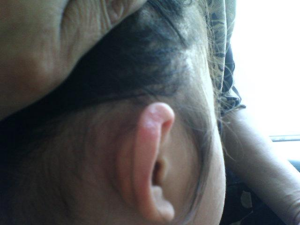

------------------------------------------------------------


In [75]:
# Filter for 'Not mentioned' in CQID035
not_mentioned_035_df = combined_df[
    (combined_df['selected_answer'] == "Not mentioned") &
    (combined_df['base_qid'] == "CQID035")
]

# Display a few examples
for _, row in not_mentioned_035_df.head(5).iterrows():
    print(f"Encounter: {row['encounter_id']}")
    print(f"Image ID: {row['image_id']}")
    print(f"Question: {row['question_text']}")
    print(f"Answer: {row['selected_answer']}")
    print(f"Query Title: {row.get('query_title_en', '')}")
    print(f"Query Content: {row.get('query_content_en', '')}")
    
    try:
        image = Image.open(row['image_path'])
        image.thumbnail((300, 300))
        display(image)
    except Exception as e:
        print(f"[Error displaying image: {e}]")
    
    print("-" * 60)

Encounter: ENC00001
Image ID: IMG_ENC00001_00001.jpg
Question: How many skin lesions are there?
Answer: multiple (please specify)
Query Title: Pleural effusion accompanied by rash
Query Content: A patient with pleural effusion is accompanied by a systemic rash, as seen in the picture (currently only the back picture is available).


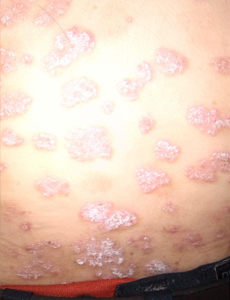

------------------------------------------------------------
Encounter: ENC00001
Image ID: IMG_ENC00001_00002.jpg
Question: How many skin lesions are there?
Answer: multiple (please specify)
Query Title: Pleural effusion accompanied by rash
Query Content: A patient with pleural effusion is accompanied by a systemic rash, as seen in the picture (currently only the back picture is available).


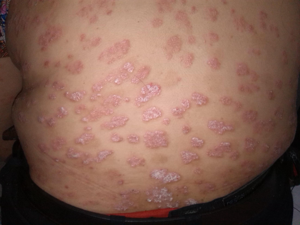

------------------------------------------------------------
Encounter: ENC00002
Image ID: IMG_ENC00002_00001.jpg
Question: How many skin lesions are there?
Answer: single
Query Title: What is on the bottom of the right foot?
Query Content: The patient is a 50-year-old male, who has been experiencing pain in the sole of his right foot while walking for six months. Physical examination: The sole of the right foot is pale, tender to light touch, no paleness in the left foot. See the picture of the right foot above.


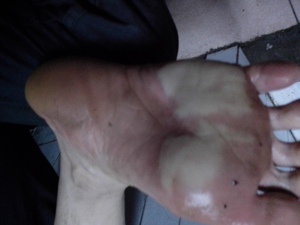

------------------------------------------------------------
Encounter: ENC00002
Image ID: IMG_ENC00002_00002.jpg
Question: How many skin lesions are there?
Answer: single
Query Title: What is on the bottom of the right foot?
Query Content: The patient is a 50-year-old male, who has been experiencing pain in the sole of his right foot while walking for six months. Physical examination: The sole of the right foot is pale, tender to light touch, no paleness in the left foot. See the picture of the right foot above.


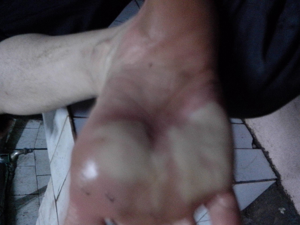

------------------------------------------------------------
Encounter: ENC00002
Image ID: IMG_ENC00002_00003.jpg
Question: How many skin lesions are there?
Answer: single
Query Title: What is on the bottom of the right foot?
Query Content: The patient is a 50-year-old male, who has been experiencing pain in the sole of his right foot while walking for six months. Physical examination: The sole of the right foot is pale, tender to light touch, no paleness in the left foot. See the picture of the right foot above.


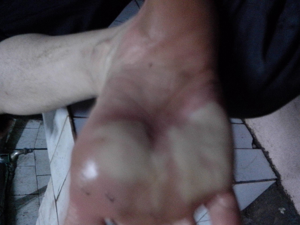

------------------------------------------------------------


In [76]:
# Filter for answers other than 'Not mentioned' in CQID035
mentioned_035_df = combined_df[
    (combined_df['selected_answer'] != "Not mentioned") &
    (combined_df['base_qid'] == "CQID035")
]

# Display a few examples
for _, row in mentioned_035_df.head(5).iterrows():
    print(f"Encounter: {row['encounter_id']}")
    print(f"Image ID: {row['image_id']}")
    print(f"Question: {row['question_text']}")
    print(f"Answer: {row['selected_answer']}")
    print(f"Query Title: {row.get('query_title_en', '')}")
    print(f"Query Content: {row.get('query_content_en', '')}")
    
    try:
        image = Image.open(row['image_path'])
        image.thumbnail((300, 300))
        display(image)
    except Exception as e:
        print(f"[Error displaying image: {e}]")
    
    print("-" * 60)

Encounter: ENC00001
Image ID: IMG_ENC00001_00001.jpg
Question: How many skin lesions are there?
Answer: multiple (please specify)
Query Title: Pleural effusion accompanied by rash
Query Content: A patient with pleural effusion is accompanied by a systemic rash, as seen in the picture (currently only the back picture is available).


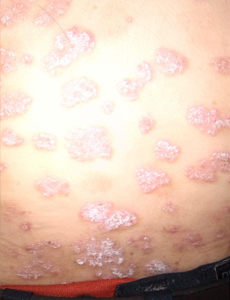

------------------------------------------------------------
Encounter: ENC00001
Image ID: IMG_ENC00001_00002.jpg
Question: How many skin lesions are there?
Answer: multiple (please specify)
Query Title: Pleural effusion accompanied by rash
Query Content: A patient with pleural effusion is accompanied by a systemic rash, as seen in the picture (currently only the back picture is available).


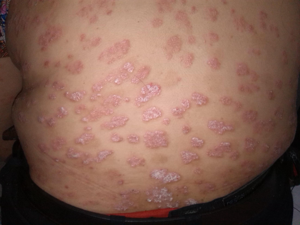

------------------------------------------------------------
Encounter: ENC00003
Image ID: IMG_ENC00003_00001.jpg
Question: How many skin lesions are there?
Answer: multiple (please specify)
Query Title: Interpreting Images - Is it magical skin?
Query Content: Male, 65 years old, skin lesions as shown in the picture, sometimes mild, sometimes severe for more than ten years, intense itching, regardless of day or night.


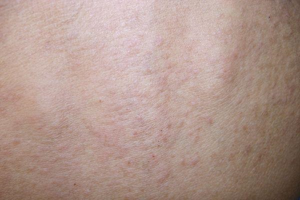

------------------------------------------------------------
Encounter: ENC00003
Image ID: IMG_ENC00003_00002.jpg
Question: How many skin lesions are there?
Answer: multiple (please specify)
Query Title: Interpreting Images - Is it magical skin?
Query Content: Male, 65 years old, skin lesions as shown in the picture, sometimes mild, sometimes severe for more than ten years, intense itching, regardless of day or night.


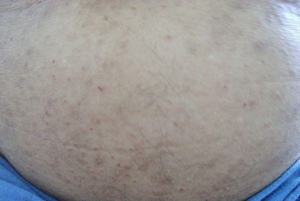

------------------------------------------------------------
Encounter: ENC00003
Image ID: IMG_ENC00003_00003.jpg
Question: How many skin lesions are there?
Answer: multiple (please specify)
Query Title: Interpreting Images - Is it magical skin?
Query Content: Male, 65 years old, skin lesions as shown in the picture, sometimes mild, sometimes severe for more than ten years, intense itching, regardless of day or night.


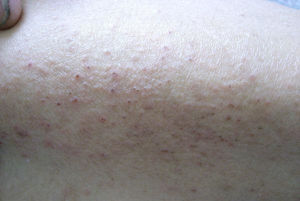

------------------------------------------------------------


In [77]:
# Filter for answers other than 'Not mentioned' in CQID035
multiple_035_df = combined_df[
    (combined_df['selected_answer'] == "multiple (please specify)") &
    (combined_df['base_qid'] == "CQID035")
]

# Display a few examples
for _, row in multiple_035_df.head(5).iterrows():
    print(f"Encounter: {row['encounter_id']}")
    print(f"Image ID: {row['image_id']}")
    print(f"Question: {row['question_text']}")
    print(f"Answer: {row['selected_answer']}")
    print(f"Query Title: {row.get('query_title_en', '')}")
    print(f"Query Content: {row.get('query_content_en', '')}")
    
    try:
        image = Image.open(row['image_path'])
        image.thumbnail((300, 300))
        display(image)
    except Exception as e:
        print(f"[Error displaying image: {e}]")
    
    print("-" * 60)

Encounter: ENC00002
Image ID: IMG_ENC00002_00001.jpg
Question: How many skin lesions are there?
Answer: single
Query Title: What is on the bottom of the right foot?
Query Content: The patient is a 50-year-old male, who has been experiencing pain in the sole of his right foot while walking for six months. Physical examination: The sole of the right foot is pale, tender to light touch, no paleness in the left foot. See the picture of the right foot above.


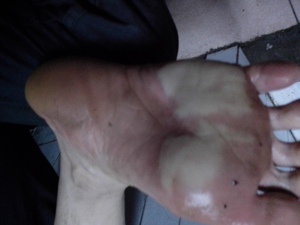

------------------------------------------------------------
Encounter: ENC00002
Image ID: IMG_ENC00002_00002.jpg
Question: How many skin lesions are there?
Answer: single
Query Title: What is on the bottom of the right foot?
Query Content: The patient is a 50-year-old male, who has been experiencing pain in the sole of his right foot while walking for six months. Physical examination: The sole of the right foot is pale, tender to light touch, no paleness in the left foot. See the picture of the right foot above.


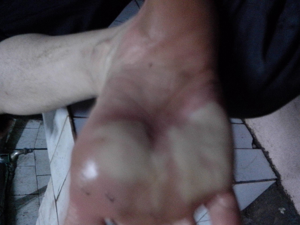

------------------------------------------------------------
Encounter: ENC00002
Image ID: IMG_ENC00002_00003.jpg
Question: How many skin lesions are there?
Answer: single
Query Title: What is on the bottom of the right foot?
Query Content: The patient is a 50-year-old male, who has been experiencing pain in the sole of his right foot while walking for six months. Physical examination: The sole of the right foot is pale, tender to light touch, no paleness in the left foot. See the picture of the right foot above.


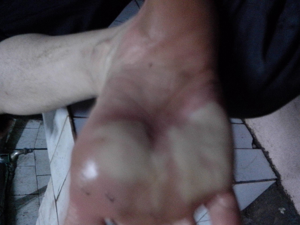

------------------------------------------------------------
Encounter: ENC00002
Image ID: IMG_ENC00002_00004.jpg
Question: How many skin lesions are there?
Answer: single
Query Title: What is on the bottom of the right foot?
Query Content: The patient is a 50-year-old male, who has been experiencing pain in the sole of his right foot while walking for six months. Physical examination: The sole of the right foot is pale, tender to light touch, no paleness in the left foot. See the picture of the right foot above.


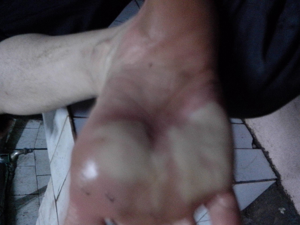

------------------------------------------------------------
Encounter: ENC00015
Image ID: IMG_ENC00015_00001.jpg
Question: How many skin lesions are there?
Answer: single
Query Title: Speak from the picture
Query Content: Take a look at her fingers.


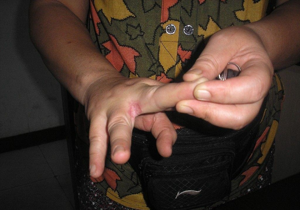

------------------------------------------------------------


In [78]:
# Filter for answers other than 'Not mentioned' in CQID035
single_035_df = combined_df[
    (combined_df['selected_answer'] == "single") &
    (combined_df['base_qid'] == "CQID035")
]

# Display a few examples
for _, row in single_035_df.head(5).iterrows():
    print(f"Encounter: {row['encounter_id']}")
    print(f"Image ID: {row['image_id']}")
    print(f"Question: {row['question_text']}")
    print(f"Answer: {row['selected_answer']}")
    print(f"Query Title: {row.get('query_title_en', '')}")
    print(f"Query Content: {row.get('query_content_en', '')}")
    
    try:
        image = Image.open(row['image_path'])
        image.thumbnail((300, 300))
        display(image)
    except Exception as e:
        print(f"[Error displaying image: {e}]")
    
    print("-" * 60)

Encounter: ENC00002
Image ID: IMG_ENC00002_00001.jpg
Question: What is the skin lesion texture?
Answer: Not mentioned
Query Title: What is on the bottom of the right foot?
Query Content: The patient is a 50-year-old male, who has been experiencing pain in the sole of his right foot while walking for six months. Physical examination: The sole of the right foot is pale, tender to light touch, no paleness in the left foot. See the picture of the right foot above.


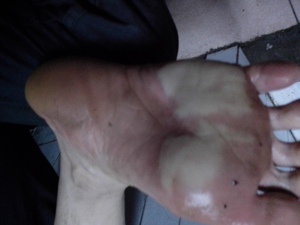

------------------------------------------------------------
Encounter: ENC00002
Image ID: IMG_ENC00002_00002.jpg
Question: What is the skin lesion texture?
Answer: Not mentioned
Query Title: What is on the bottom of the right foot?
Query Content: The patient is a 50-year-old male, who has been experiencing pain in the sole of his right foot while walking for six months. Physical examination: The sole of the right foot is pale, tender to light touch, no paleness in the left foot. See the picture of the right foot above.


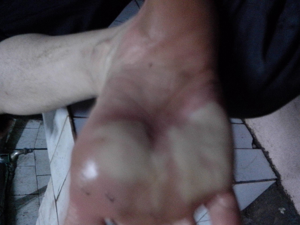

------------------------------------------------------------
Encounter: ENC00002
Image ID: IMG_ENC00002_00003.jpg
Question: What is the skin lesion texture?
Answer: Not mentioned
Query Title: What is on the bottom of the right foot?
Query Content: The patient is a 50-year-old male, who has been experiencing pain in the sole of his right foot while walking for six months. Physical examination: The sole of the right foot is pale, tender to light touch, no paleness in the left foot. See the picture of the right foot above.


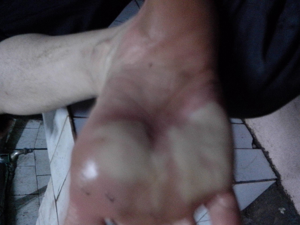

------------------------------------------------------------
Encounter: ENC00002
Image ID: IMG_ENC00002_00004.jpg
Question: What is the skin lesion texture?
Answer: Not mentioned
Query Title: What is on the bottom of the right foot?
Query Content: The patient is a 50-year-old male, who has been experiencing pain in the sole of his right foot while walking for six months. Physical examination: The sole of the right foot is pale, tender to light touch, no paleness in the left foot. See the picture of the right foot above.


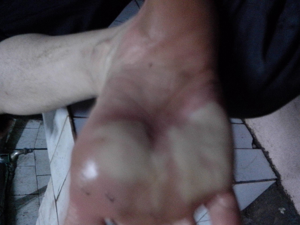

------------------------------------------------------------
Encounter: ENC00003
Image ID: IMG_ENC00003_00001.jpg
Question: What is the skin lesion texture?
Answer: Not mentioned
Query Title: Interpreting Images - Is it magical skin?
Query Content: Male, 65 years old, skin lesions as shown in the picture, sometimes mild, sometimes severe for more than ten years, intense itching, regardless of day or night.


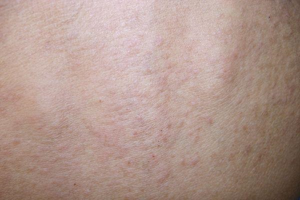

------------------------------------------------------------


In [79]:
# Filter for 'Not mentioned' in CQID036
not_mentioned_036_df = combined_df[
    (combined_df['selected_answer'] == "Not mentioned") &
    (combined_df['base_qid'] == "CQID036")
]

# Display a few examples
for _, row in not_mentioned_036_df.head(5).iterrows():
    print(f"Encounter: {row['encounter_id']}")
    print(f"Image ID: {row['image_id']}")
    print(f"Question: {row['question_text']}")
    print(f"Answer: {row['selected_answer']}")
    print(f"Query Title: {row.get('query_title_en', '')}")
    print(f"Query Content: {row.get('query_content_en', '')}")
    
    try:
        image = Image.open(row['image_path'])
        image.thumbnail((300, 300))
        display(image)
    except Exception as e:
        print(f"[Error displaying image: {e}]")
    
    print("-" * 60)

Encounter: ENC00425
Image ID: IMG_ENC00425_00005.jpg
Question: What is the skin lesion texture?
Answer: Not mentioned
Query Title: Diagnosis based on the image?
Query Content: Patient has a history of the disease for 3 years, with a small amount of secretion when pressing the local area. Fungus test from another hospital was negative.


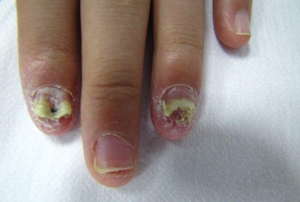

------------------------------------------------------------
Encounter: ENC00425
Image ID: IMG_ENC00425_00006.jpg
Question: What is the skin lesion texture?
Answer: Not mentioned
Query Title: Diagnosis based on the image?
Query Content: Patient has a history of the disease for 3 years, with a small amount of secretion when pressing the local area. Fungus test from another hospital was negative.


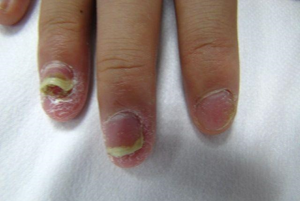

------------------------------------------------------------
Encounter: ENC00446
Image ID: IMG_ENC00446_00001.jpg
Question: What is the skin lesion texture?
Answer: Not mentioned
Query Title: What's wrong with the right fingernail?
Query Content: Female, 58 years old, farmer, no systemic diseases, no special contact history.


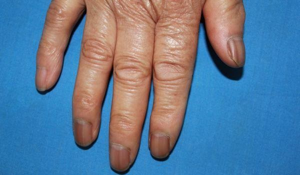

------------------------------------------------------------
Encounter: ENC00446
Image ID: IMG_ENC00446_00002.jpg
Question: What is the skin lesion texture?
Answer: Not mentioned
Query Title: What's wrong with the right fingernail?
Query Content: Female, 58 years old, farmer, no systemic diseases, no special contact history.


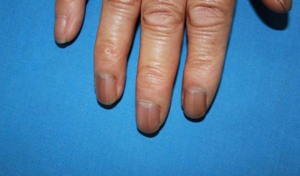

------------------------------------------------------------
Encounter: ENC00446
Image ID: IMG_ENC00446_00003.jpg
Question: What is the skin lesion texture?
Answer: Not mentioned
Query Title: What's wrong with the right fingernail?
Query Content: Female, 58 years old, farmer, no systemic diseases, no special contact history.


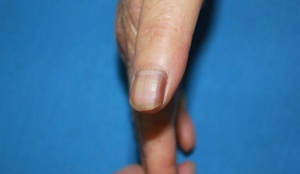

------------------------------------------------------------


In [80]:
# Filter for 'Not mentioned' in CQID036
not_mentioned_036_df = combined_df[
    (combined_df['selected_answer'] == "Not mentioned") &
    (combined_df['base_qid'] == "CQID036")
]

# Display a few examples
for _, row in not_mentioned_036_df.tail(5).iterrows():
    print(f"Encounter: {row['encounter_id']}")
    print(f"Image ID: {row['image_id']}")
    print(f"Question: {row['question_text']}")
    print(f"Answer: {row['selected_answer']}")
    print(f"Query Title: {row.get('query_title_en', '')}")
    print(f"Query Content: {row.get('query_content_en', '')}")
    
    try:
        image = Image.open(row['image_path'])
        image.thumbnail((300, 300))
        display(image)
    except Exception as e:
        print(f"[Error displaying image: {e}]")
    
    print("-" * 60)

Encounter: ENC00001
Image ID: IMG_ENC00001_00001.jpg
Question: What is the skin lesion texture?
Answer: rough
Query Title: Pleural effusion accompanied by rash
Query Content: A patient with pleural effusion is accompanied by a systemic rash, as seen in the picture (currently only the back picture is available).


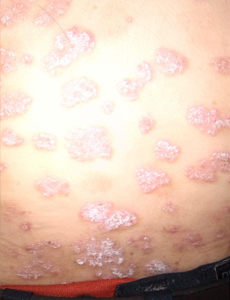

------------------------------------------------------------
Encounter: ENC00001
Image ID: IMG_ENC00001_00002.jpg
Question: What is the skin lesion texture?
Answer: rough
Query Title: Pleural effusion accompanied by rash
Query Content: A patient with pleural effusion is accompanied by a systemic rash, as seen in the picture (currently only the back picture is available).


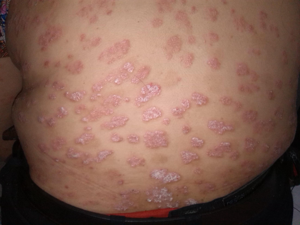

------------------------------------------------------------
Encounter: ENC00022
Image ID: IMG_ENC00022_00001.jpg
Question: What is the skin lesion texture?
Answer: smooth
Query Title: Diagnose Disease from Pictures
Query Content: Patient: Female, 65 years old. She had breast cancer surgery 5 years ago. Five days ago, a ring-shaped rash appeared on her torso, slowly expanding outward, with no pain or itching.


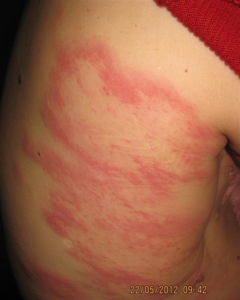

------------------------------------------------------------
Encounter: ENC00022
Image ID: IMG_ENC00022_00002.jpg
Question: What is the skin lesion texture?
Answer: smooth
Query Title: Diagnose Disease from Pictures
Query Content: Patient: Female, 65 years old. She had breast cancer surgery 5 years ago. Five days ago, a ring-shaped rash appeared on her torso, slowly expanding outward, with no pain or itching.


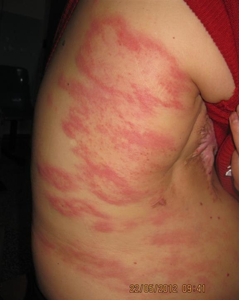

------------------------------------------------------------
Encounter: ENC00022
Image ID: IMG_ENC00022_00003.jpg
Question: What is the skin lesion texture?
Answer: smooth
Query Title: Diagnose Disease from Pictures
Query Content: Patient: Female, 65 years old. She had breast cancer surgery 5 years ago. Five days ago, a ring-shaped rash appeared on her torso, slowly expanding outward, with no pain or itching.


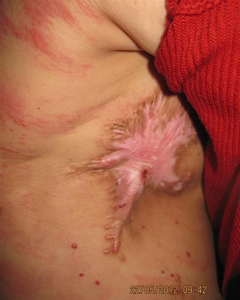

------------------------------------------------------------


In [81]:
# Filter for answers other than 'Not mentioned' in CQID036
mentioned_036_df = combined_df[
    (combined_df['selected_answer'] != "Not mentioned") &
    (combined_df['base_qid'] == "CQID036")
]

# Display a few examples
for _, row in mentioned_036_df.head(5).iterrows():
    print(f"Encounter: {row['encounter_id']}")
    print(f"Image ID: {row['image_id']}")
    print(f"Question: {row['question_text']}")
    print(f"Answer: {row['selected_answer']}")
    print(f"Query Title: {row.get('query_title_en', '')}")
    print(f"Query Content: {row.get('query_content_en', '')}")
    
    try:
        image = Image.open(row['image_path'])
        image.thumbnail((300, 300))
        display(image)
    except Exception as e:
        print(f"[Error displaying image: {e}]")
    
    print("-" * 60)

In [82]:
# Filter combined_df for relevant QIDs and "Not mentioned"
target_qids = ["CQID015", "CQID025", "CQID036"]
not_mentioned_subset = combined_df[
    (combined_df['base_qid'].isin(target_qids)) &
    (combined_df['selected_answer'] == "Not mentioned")
]

# Pivot to get one row per encounter with QID-wise "Not mentioned" presence
not_mentioned_flags = not_mentioned_subset.pivot_table(
    index='encounter_id',
    columns='base_qid',
    values='selected_answer',
    aggfunc='first'
).notna().astype(int)

# Fill missing values (i.e., not "Not mentioned") with 0
not_mentioned_flags = not_mentioned_flags.reindex(columns=target_qids, fill_value=0)

# Calculate overlaps
not_mentioned_flags['sum'] = not_mentioned_flags.sum(axis=1)

# Count number of encounters per overlap pattern
pattern_counts = not_mentioned_flags['sum'].value_counts().sort_index()

# Display overlap likelihood
total_encounters = combined_df['encounter_id'].nunique()
print("Overlap of 'Not mentioned' answers across CQID015, CQID025, CQID036:")
for count, num_encounters in pattern_counts.items():
    percentage = (num_encounters / total_encounters) * 100
    print(f"{count} of 3 questions marked 'Not mentioned': {num_encounters} encounters ({percentage:.1f}%)")

Overlap of 'Not mentioned' answers across CQID015, CQID025, CQID036:
1 of 3 questions marked 'Not mentioned': 125 encounters (41.7%)
2 of 3 questions marked 'Not mentioned': 101 encounters (33.7%)
3 of 3 questions marked 'Not mentioned': 43 encounters (14.3%)


In [87]:
# Define target QIDs for analysis
qid_target = ["CQID020", "CQID012"]

# Filter down to those QIDs first
target_df = combined_df[combined_df["base_qid"].isin(qid_target)]

# Group by encounter + question and count unique answers
multi_answer_encounters = (
    target_df.groupby(["encounter_id", "base_qid"])["selected_answer"]
    .nunique()
    .reset_index()
)
multi_answer_encounters = multi_answer_encounters[multi_answer_encounters["selected_answer"] > 1]

print(f"Found {len(multi_answer_encounters)} encounter-question pairs with multiple answers")
print(multi_answer_encounters[["encounter_id", "base_qid", "selected_answer"]].head())

# Join back to original data to display full rows for those cases
filtered_df = target_df.merge(
    multi_answer_encounters[["encounter_id", "base_qid"]],
    on=["encounter_id", "base_qid"],
    how="inner"
)

print(f"\nTotal rows in filtered dataset: {len(filtered_df)}")

# Display a summary of image counts per encounter-question pair
summary = filtered_df.groupby(['encounter_id', 'base_qid']).agg(
    image_count=('image_id', 'nunique'),
    answer_count=('selected_answer', 'nunique'),
    unique_answers=('selected_answer', lambda x: list(set(x)))
).reset_index()

print("\nSummary of unique answers per encounter-question pair:")
for _, row in summary.head(10).iterrows():
    print(f"Encounter: {row['encounter_id']}, Question: {row['base_qid']}")
    print(f"  Number of images: {row['image_count']}")
    print(f"  Number of unique answers: {row['answer_count']}")
    print(f"  Unique answers: {row['unique_answers']}")
    print()

# Display examples, grouping by encounter-question
current_encounter = None
current_qid = None
count = 0
max_examples = 5  # Limit the number of examples to display

for _, row in filtered_df.iterrows():
    # Only show a limited number of encounter-question pairs
    if current_encounter != row['encounter_id'] or current_qid != row['base_qid']:
        current_encounter = row['encounter_id']
        current_qid = row['base_qid']
        count += 1
        if count > max_examples:
            break
        print(f"\n{'='*80}")
        print(f"ENCOUNTER: {row['encounter_id']}, QUESTION: {row['base_qid']}")
        print(f"QUESTION TEXT: {row['question_text']}")
        print(f"VALID ANSWERS: {row['valid_answers']}")
        print(f"QUERY TITLE: {row.get('query_title_en', '')}")
        print(f"QUERY CONTENT: {row.get('query_content_en', '')}")
        print(f"{'-'*80}")
    
    print(f"Image ID: {row['image_id']}")
    print(f"Selected Answer: {row['selected_answer']}")
    print(f"{'-'*30}")

# Find cases where a single image has multiple valid answers according to the dataset
has_multiple_valid = combined_df['valid_answers_list'].apply(lambda x: len(x) > 1)
single_image_multi_label = combined_df[has_multiple_valid & combined_df['base_qid'].isin(qid_target)]

print(f"\n\nFound {len(single_image_multi_label)} rows where a single image has multiple valid answers for CQID020 or CQID012")

# Group by image_id and check if any image has multiple selected answers
image_answer_counts = filtered_df.groupby(['image_id'])['selected_answer'].nunique().reset_index()
images_with_multiple_answers = image_answer_counts[image_answer_counts['selected_answer'] > 1]

print(f"\nFound {len(images_with_multiple_answers)} images that have been assigned multiple different answers")

Found 19 encounter-question pairs with multiple answers
    encounter_id base_qid  selected_answer
11      ENC00006  CQID020                2
44      ENC00023  CQID012                2
105     ENC00054  CQID020                2
229     ENC00136  CQID020                2
295     ENC00250  CQID020                2

Total rows in filtered dataset: 76

Summary of unique answers per encounter-question pair:
Encounter: ENC00006, Question: CQID020
  Number of images: 3
  Number of unique answers: 2
  Unique answers: ['raised or bumpy', 'crust']

Encounter: ENC00023, Question: CQID012
  Number of images: 4
  Number of unique answers: 2
  Unique answers: ['larger area', 'size of palm']

Encounter: ENC00054, Question: CQID020
  Number of images: 3
  Number of unique answers: 2
  Unique answers: ['raised or bumpy', 'crust']

Encounter: ENC00136, Question: CQID020
  Number of images: 4
  Number of unique answers: 2
  Unique answers: ['raised or bumpy', 'scab']

Encounter: ENC00250, Question: CQID0

In [83]:
# Load the combined dataset
# combined_df = pd.read_csv("outputs/combined_dataset.csv")

# Load train.json to get author_id information
train_json_path = os.path.join(DATASET_DIR, "train.json")
train_df = pd.read_json(train_json_path)

# Extract relevant columns from train_df
author_df = train_df[["encounter_id", "author_id"]]

# Merge author information into combined_df
combined_df_with_author = combined_df.merge(author_df, on="encounter_id", how="left")

# Save the updated dataframe with author information
combined_df_with_author.to_csv("outputs/combined_dataset_with_author.csv", index=False)

# Analyze "Not mentioned" prevalence by author
print("Analyzing 'Not mentioned' prevalence by author...")

# Filter for rows where selected_answer is "Not mentioned"
not_mentioned_df = combined_df_with_author[combined_df_with_author['selected_answer'] == "Not mentioned"]

# Get total counts per author
author_counts = combined_df_with_author['author_id'].value_counts().reset_index()
author_counts.columns = ['author_id', 'total_labels']

# Get "Not mentioned" counts per author
not_mentioned_counts = not_mentioned_df['author_id'].value_counts().reset_index()
not_mentioned_counts.columns = ['author_id', 'not_mentioned_count']

# Merge the counts
author_analysis = author_counts.merge(not_mentioned_counts, on='author_id', how='left')

# Fill NaN values with 0 (authors who never used "Not mentioned")
author_analysis['not_mentioned_count'] = author_analysis['not_mentioned_count'].fillna(0).astype(int)

# Calculate percentage
author_analysis['not_mentioned_percentage'] = (author_analysis['not_mentioned_count'] / author_analysis['total_labels'] * 100).round(2)

# Sort by percentage in descending order
author_analysis = author_analysis.sort_values('not_mentioned_percentage', ascending=False)

# Display results
print("\nAuthors ranked by 'Not mentioned' usage percentage:")
print(author_analysis.head(10))

# Additional analysis by question type
print("\nBreakdown of 'Not mentioned' usage by author and question type:")

# Group by author_id and base_qid
author_qid_counts = combined_df_with_author.groupby(['author_id', 'base_qid']).size().reset_index(name='total_count')

# Group by author_id, base_qid for just "Not mentioned" labels
not_mentioned_qid_counts = not_mentioned_df.groupby(['author_id', 'base_qid']).size().reset_index(name='not_mentioned_count')

# Merge the counts
author_qid_analysis = author_qid_counts.merge(not_mentioned_qid_counts, on=['author_id', 'base_qid'], how='left')

# Fill NaNs and calculate percentage
author_qid_analysis['not_mentioned_count'] = author_qid_analysis['not_mentioned_count'].fillna(0).astype(int)
author_qid_analysis['percentage'] = (author_qid_analysis['not_mentioned_count'] / author_qid_analysis['total_count'] * 100).round(2)

# Sort for better readability
author_qid_analysis = author_qid_analysis.sort_values(['author_id', 'percentage'], ascending=[True, False])

# Get top 5 authors with highest overall "Not mentioned" percentage
top_authors = author_analysis.head(5)['author_id'].tolist()

# Filter for just those top authors in the detailed analysis
top_author_details = author_qid_analysis[author_qid_analysis['author_id'].isin(top_authors)]

print("\nDetailed breakdown for top 5 authors with highest 'Not mentioned' usage:")
for author in top_authors:
    author_data = top_author_details[top_author_details['author_id'] == author]
    print(f"\nAuthor ID: {author}")
    print(author_data[['base_qid', 'total_count', 'not_mentioned_count', 'percentage']].sort_values('percentage', ascending=False))

Analyzing 'Not mentioned' prevalence by author...

Authors ranked by 'Not mentioned' usage percentage:
    author_id  total_labels  not_mentioned_count  not_mentioned_percentage
120    U12731            18                   14                     77.78
181    U16894            18                   10                     55.56
33     U00170            54                   24                     44.44
28     U01956            63                   27                     42.86
23     U00194            63                   26                     41.27
43     U00542            45                   15                     33.33
47     U09344            36                   12                     33.33
83     U13156            27                    9                     33.33
67     U18541            36                   12                     33.33
63     U20363            36                   12                     33.33

Breakdown of 'Not mentioned' usage by author and question type:

Detail

In [84]:
combined_df.head()

,encounter_id,base_qid,image_id,image_path,valid_answers,question_text,selected_answer,query_title_en,query_content_en,options_en,question_type_en,question_category_en,answer_index,valid_answers_list,has_multiple_valid
0,ENC00003,CQID011,IMG_ENC00003_00001.jpg,/storage/coda1/p-dsgt_clef2025/0/kthakrar3/med...,"['back', 'chest/abdomen']",1 Where is the affected area?,chest/abdomen,Interpreting Images - Is it magical skin?,"Male, 65 years old, skin lesions as shown in t...","[head, neck, upper extremities, lower extremit...",Site Location,General,4,"[back, chest/abdomen]",True
1,ENC00003,CQID011,IMG_ENC00003_00002.jpg,/storage/coda1/p-dsgt_clef2025/0/kthakrar3/med...,"['back', 'chest/abdomen']",1 Where is the affected area?,chest/abdomen,Interpreting Images - Is it magical skin?,"Male, 65 years old, skin lesions as shown in t...","[head, neck, upper extremities, lower extremit...",Site Location,General,4,"[back, chest/abdomen]",True
2,ENC00003,CQID011,IMG_ENC00003_00003.jpg,/storage/coda1/p-dsgt_clef2025/0/kthakrar3/med...,"['back', 'chest/abdomen']",1 Where is the affected area?,back,Interpreting Images - Is it magical skin?,"Male, 65 years old, skin lesions as shown in t...","[head, neck, upper extremities, lower extremit...",Site Location,General,5,"[back, chest/abdomen]",True
3,ENC00003,CQID011,IMG_ENC00003_00004.jpg,/storage/coda1/p-dsgt_clef2025/0/kthakrar3/med...,"['back', 'chest/abdomen']",1 Where is the affected area?,back,Interpreting Images - Is it magical skin?,"Male, 65 years old, skin lesions as shown in t...","[head, neck, upper extremities, lower extremit...",Site Location,General,5,"[back, chest/abdomen]",True
4,ENC00003,CQID011,IMG_ENC00003_00005.jpg,/storage/coda1/p-dsgt_clef2025/0/kthakrar3/med...,"['back', 'chest/abdomen']",1 Where is the affected area?,back,Interpreting Images - Is it magical skin?,"Male, 65 years old, skin lesions as shown in t...","[head, neck, upper extremities, lower extremit...",Site Location,General,5,"[back, chest/abdomen]",True
